## MERFISH mouse liver: Notebook to determine ROIs for overlapping cells in 3d spot-based transcriptomics data

This notebook contains a prototype implementation of an ovrl.py analysis script for vizgen's MERFISH liver showcase data set. It runs tha basic ovrlpy analysis pipeline and stores the result;

#### Imports:

In [2]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
import os
# from collections import defaultdict

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
# from sklearn.neighbors import NearestNeighbors
import anndata
import time

perf = time.perf_counter()
perf_ = perf

print(time.perf_counter()-perf)

6.0069840401411057e-05


#### Parameter definition:

In [4]:
n_sample = 1
n_slice = 1

img_path_wall = f'../../vizgen-merfish/vz-liver-showcase/Liver{n_sample}Slice{n_slice}/images/mosaic_Cellbound3_z4.tif'
img_path_dapi = f'../../vizgen-merfish/vz-liver-showcase/Liver{n_sample}Slice{n_slice}/images/mosaic_DAPI_z4.tif'
coordinate_path = f'../../../../raw_data/vizgen-merfish/vz-liver-showcase/Liver{n_sample}Slice{n_slice}/detected_transcripts.csv'

scale=1 # scaling factor for images/coordinats. We want to end up with cell diameter ~30px (cellpose default)
model_type='cyto2' # cellpose model name. ['dapi','cyto','cyto2']

In [11]:
# Load coordinate_path data frame, read only the columns
# global_x, global_y, global_z, fov	gene:

perf_=time.perf_counter()

df = pd.read_csv(coordinate_path, sep=',', usecols=[2,3,4,8], header=0)[::1]

print(f'Loading time: {time.perf_counter()-perf_}')
perf_=time.perf_counter()


Loading time: 252.89943531388417


                  x             y             z
count  2.761887e+08  2.761887e+08  2.761887e+08
mean   3.551086e+03  3.354382e+03  2.686848e+00
std    1.993278e+03  1.977380e+03  1.882738e+00
min    1.000000e-04  6.000000e-05  0.000000e+00
25%    1.793756e+03  1.637970e+03  1.000000e+00
50%    3.618509e+03  3.353441e+03  3.000000e+00
75%    5.278261e+03  5.026416e+03  4.000000e+00
max    6.999999e+03  6.999999e+03  6.000000e+00


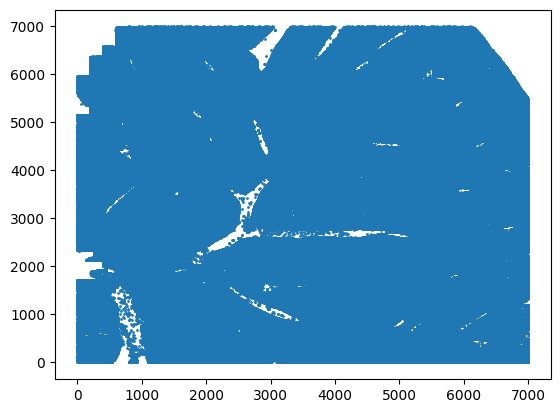

In [12]:
df.columns = ["x", "y", "z", "gene"]

df = df[~df.gene.str.contains("Blank")]
df.gene = df.gene.astype("category")

raw_df = df.copy()

gene_counts = df.gene.value_counts()
genes = gene_counts.index

x_lims = [2000, 9000]
y_lims = [1000, 8000]


mins = pd.DataFrame(
    [(0, 0)],
    columns=("x", "y"),
)

df_mask = (
    (df.x > x_lims[0]) & (df.x < x_lims[1]) & (df.y > y_lims[0]) & (df.y < y_lims[1])
)
df = df[df_mask]
df.x -= x_lims[0]
df.y -= y_lims[0]

plt.scatter(df.x[::100], df.y[::100], s=1)

coordinate_df = df.copy()
del df

coordinate_df.head()

print(coordinate_df.describe())

Running vertical adjustment
Creating gene expression embeddings for visualization:
Analyzing in 3d mode:
determining pseudocells:
found 131455 pseudocells
sampling expression:


Ugt2a3: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 347/347 [01:27<00:00,  3.97it/s]


Modeling 15 pseudo-celltype clusters;


/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/numpy/_core/_methods.py:130: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


Creating signal integrity map:


  0%|                                                                                                                                                                                                                                                             | 0/49 [00:00<?, ?it/s]/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/ovrlpy_24/ovrlpy/_utils.py:575: RuntimeWarning: invalid value encountered in divide
  patch_cosine_similarity = np.sum(
  2%|█████                                                                                                                                                                                                                                                | 1/49 [00:13<11:09, 13.94s/it]/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/ovrlpy_24/ovrlpy/_utils.py:575: RuntimeWarning: invalid value encountered in divide
  patch_cosine_similarity = np.sum(
  4%|██████████                                                                       

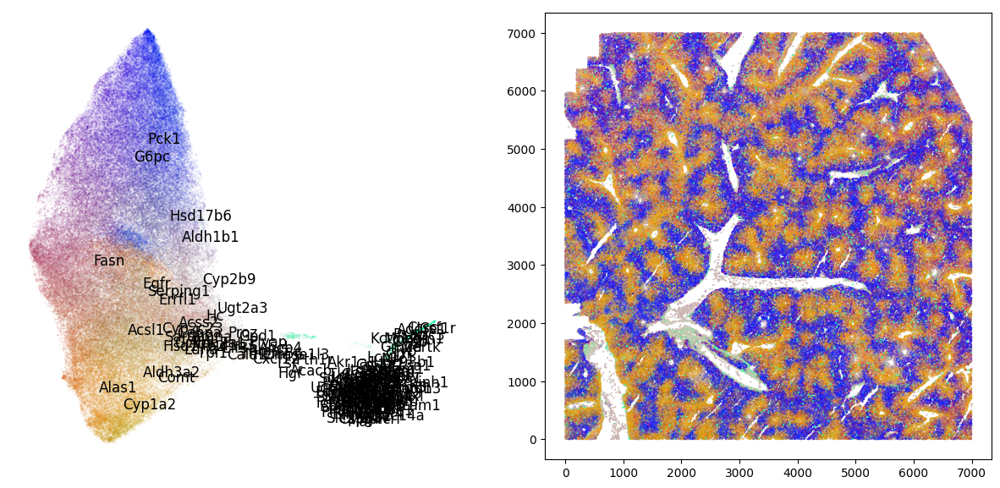

In [13]:
import sys
# the mock-0.3.1 dir contains testcase.py, testutils.py & mock.py
sys.path.append("/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24")
from ovrlpy_24 import ovrlpy 

signal_integrity, signal_strength,visualizer = ovrlpy.run(coordinate_df, cell_diameter=6.667, n_expected_celltypes=15,min_expression=1.0)

visualizer.save("./publication/vizgen-liver/vizgen-liver.vis")

visualizer.plot_fit()

In [14]:
import sys
# the mock-0.3.1 dir contains testcase.py, testutils.py & mock.py
sys.path.append("/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24")
from ovrlpy_24 import ovrlpy 

# visualizer = ovrlpy.load_visualizer("./vizgen-liver.vis")

# signal_integrity, signal_strength = visualizer.integrity_map, visualizer.signal_map

In [25]:
xlims = np.array([[1200,1450],[1550,1800],[2500,2700]])*2
ylims = np.array([[1150,1400],[2100,2350],[2550,2750]])*2

ylims

array([[2300, 2800],
       [4200, 4700],
       [5100, 5500]])

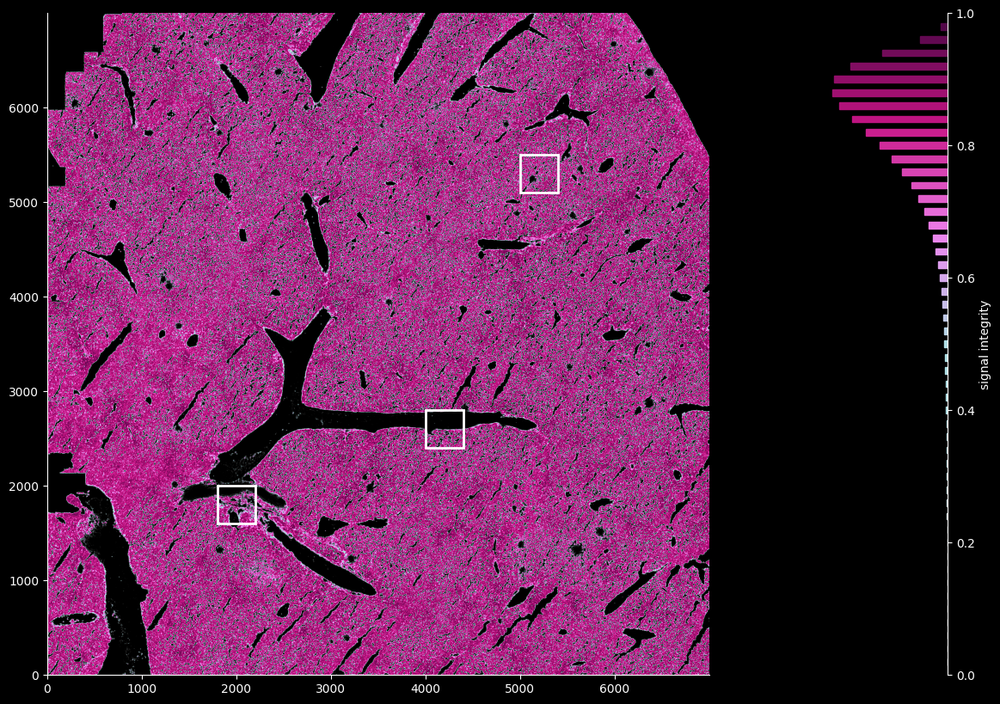

In [32]:
x_highlights = [[1800, 2200],
       [4000, 4400],
       [5000, 5400]]
y_highlights = [[1600, 2000],
       [2400, 2800],
       [5100, 5500]]  

fig, ax = ovrlpy.plot_signal_integrity(
    signal_integrity, signal_strength, signal_threshold=3
)

for i in range(3):
    ax[0].add_artist(plt.Rectangle((x_highlights[i][0],y_highlights[i][0]),
                                   x_highlights[i][1]-x_highlights[i][0],
                                   y_highlights[i][1]-y_highlights[i][0],
                                   fill=None,edgecolor='w',lw=2))
    # txt = plt.text(x_highlights[i][0]-10,y_highlights[i][1],f'{i+1}',color='w',fontsize=20,ha='right',va='top')


plt.savefig(f'./publication/vizgen-liver/figures/liver_integrity_with_highlights.svg',dpi=300)

/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


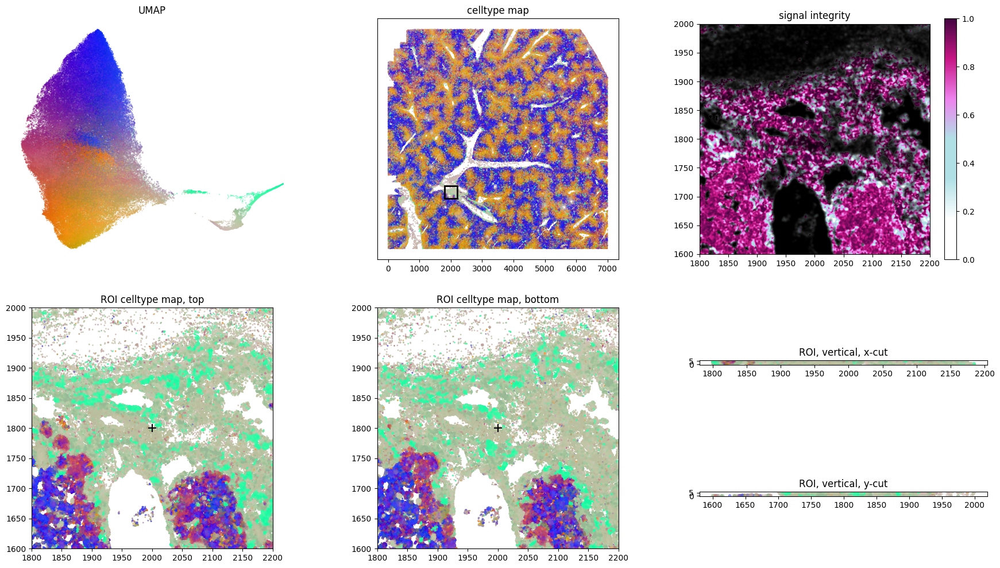

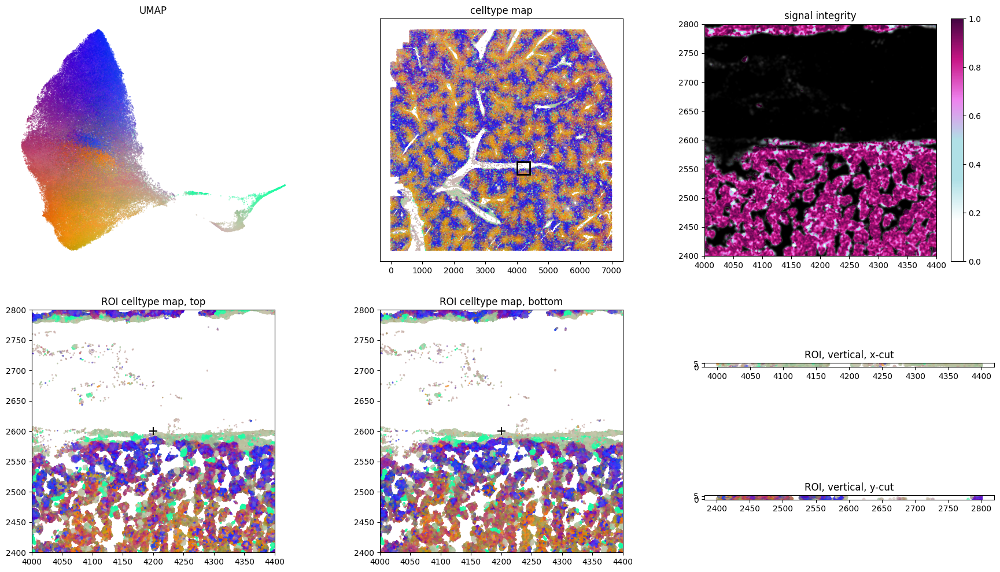

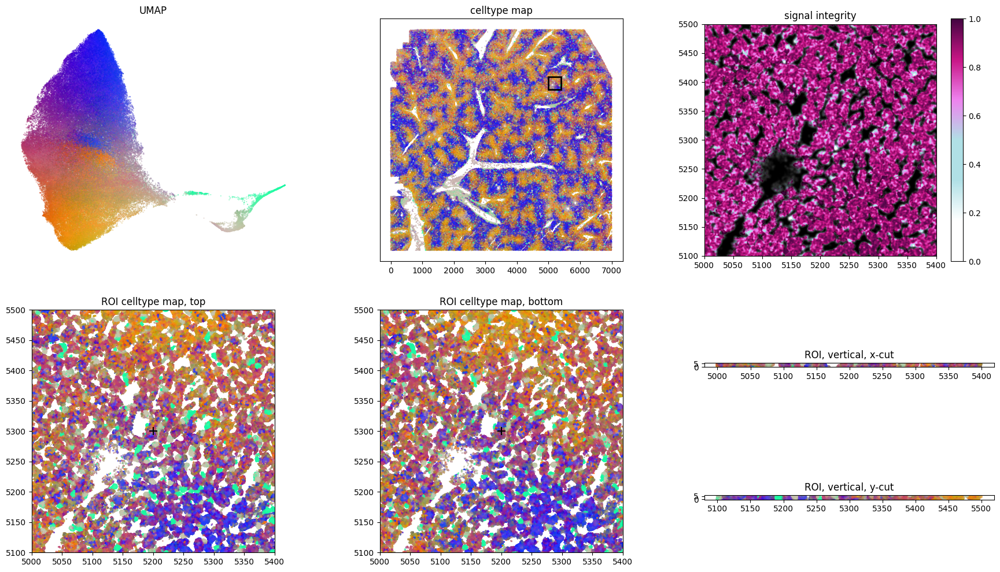

In [34]:
for i in range(len(x_highlights)):
    ovrlpy.plot_region_of_interest(x_highlights[i][0]+(x_highlights[i][1]-x_highlights[i][0])/2,
                                   y_highlights[i][0]+(y_highlights[i][1]-y_highlights[i][0])/2,
                                   coordinate_df,
                                   visualizer,
                                   signal_integrity,
                                   signal_strength,
                                   window_size=200,
                                   )
    
    plt.savefig(f'./publication/vizgen-liver/figures/liver_highlight_map_{i+1}.svg',dpi=300)

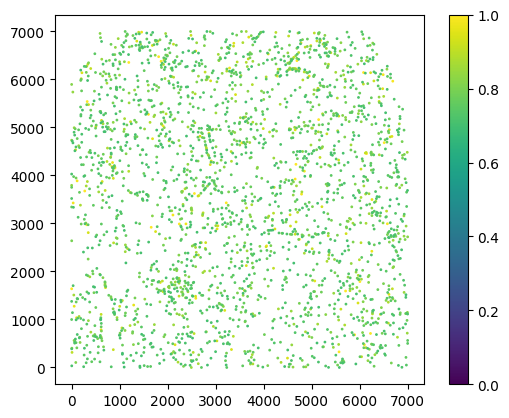

In [35]:
doublet_df = ovrlpy.detect_doublets(
    signal_integrity, signal_strength, minimum_signal_strength=3, integrity_sigma=2
)

_ = plt.scatter(
    doublet_df["x"],
    doublet_df["y"],
    c=doublet_df["integrity"],
    s=1,
    cmap="viridis",
    vmin=0,
    vmax=1,
)
plt.gca().set_aspect("equal")
plt.colorbar()

In [36]:
# window_size = 60
# doublet_case = 0

# x, y = 2900,2900#doublet_df.loc[doublet_case, ["x", "y"]]
# ovrlpy.pre_process_coordinates(coordinate_df)

# ovrlpy.plot_region_of_interest(
#     x,
#     y,
#     coordinate_df,
#     visualizer,
#     signal_integrity,
#     signal_strength,
#     window_size=window_size,
# )


/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/numpy/_core/_methods.py:130: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


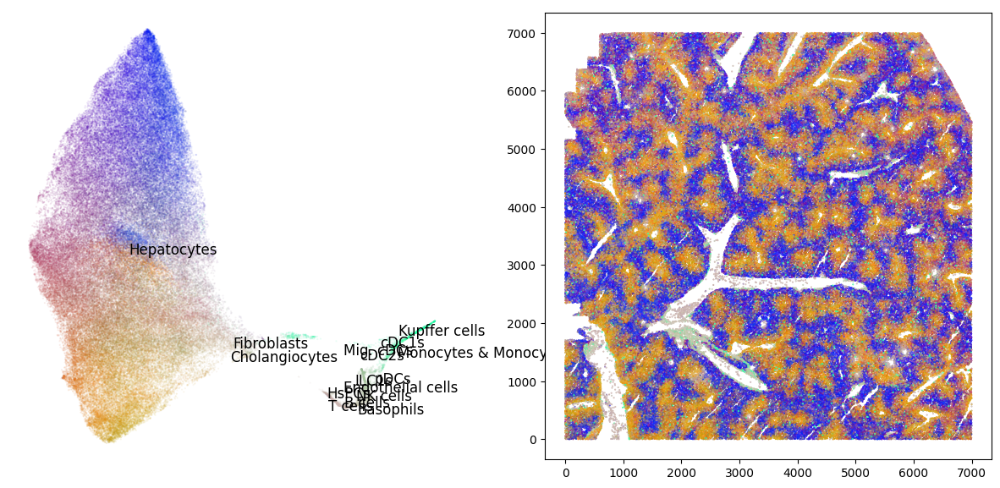

In [37]:
signatures = pd.read_csv('../ovrlpy/publication/vizgen-liver/signatures_liver_atlas.csv',index_col=0)

visualizer.fit_signatures(signatures)

visualizer.plot_fit(rasterized=True)


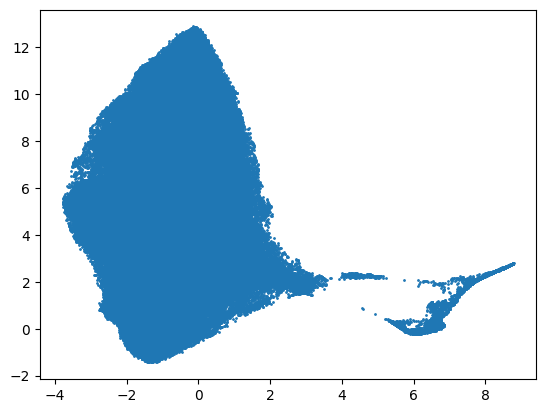

In [38]:
plt.scatter(visualizer.embedding[:, 0], visualizer.embedding[:, 1], s=1)

Modeling 12 pseudo-celltype clusters;


/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/numpy/_core/_methods.py:130: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/tmp/ipykernel_436677/696605249.py:29: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(visualizer.embedding[:, 0], visualizer.embedding[:, 1], s=1, c=rgb_array, cmap='viridis',rasterized=True)


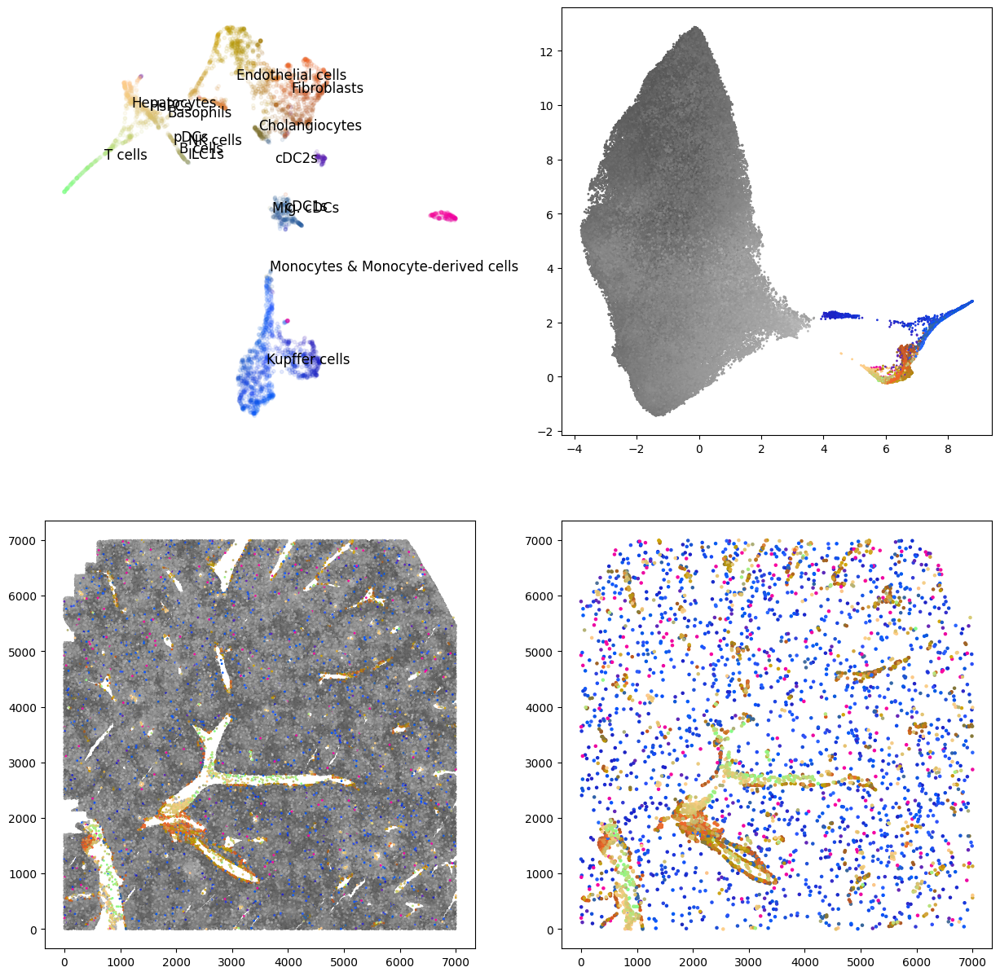

In [44]:
from sklearn.decomposition import PCA
from umap import UMAP
# from src import utils
# import random

umap_delimiter = 3.8 #values with embedding.x>umap_delimiter are stromal
stromal_mask = visualizer.embedding[:, 0] > umap_delimiter

plt.figure(figsize=(15, 15))
plt.subplot(221)

visualizer_stromal = ovrlpy.Visualizer(KDE_bandwidth=visualizer.KDE_bandwidth,
                                       celltyping_min_expression=visualizer.celltyping_min_expression,
                                       celltyping_min_distance=visualizer.celltyping_min_distance,
                                       n_components_pca=12,
                                       umap_kwargs=visualizer.umap_kwargs,
                                       cumap_kwargs=visualizer.cumap_kwargs,)

visualizer_stromal.fit_pseudocells(visualizer.pseudocell_expression_samples.iloc[:,stromal_mask])

visualizer_stromal.fit_signatures(signatures)
visualizer_stromal.plot_umap()

plt.subplot(222)
rgb_array = visualizer.colors.copy()
rgb_array[:] = rgb_array.mean(1, keepdims=True)
rgb_array[stromal_mask] = visualizer_stromal.colors.copy()  

plt.scatter(visualizer.embedding[:, 0], visualizer.embedding[:, 1], s=1, c=rgb_array, cmap='viridis',rasterized=True)


plt.subplot(223)
plt.scatter(visualizer.pseudocell_locations_x, visualizer.pseudocell_locations_y, s=1, c=rgb_array,rasterized=True)

plt.subplot(224)
plt.scatter(visualizer.pseudocell_locations_x[stromal_mask], visualizer.pseudocell_locations_y[stromal_mask], s=5, c=visualizer_stromal.colors, rasterized=True)

plt.savefig('./publication/vizgen-liver/figures/liver_stromal_umap.svg',dpi=300)

/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


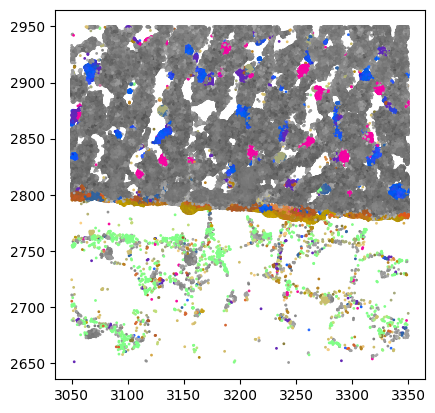

In [40]:
def colorize_liver(subsample):
    
    rgb_array = np.zeros((subsample.shape[0],3))
    
    subsample_embedding, subsample_embedding_color = visualizer.transform_transcripts(subsample)

    stromal_mask = subsample_embedding[:, 0] > umap_delimiter

    subsample_stromal = subsample[stromal_mask]
    
    subsample_embedding_stromal, subsample_embedding_color_stromal = visualizer_stromal.transform_transcripts(subsample_stromal)

    rgb_array[stromal_mask] = subsample_embedding_color_stromal
    rgb_array[~stromal_mask] = subsample_embedding_color.mean(1)[~stromal_mask][:,None]

    return subsample_embedding, rgb_array
    
subsample = visualizer.subsample_df(3200,2800,coordinate_df=coordinate_df,window_size=150)
subsample_embedding, subsample_rgb = colorize_liver(subsample)

plt.scatter(x=subsample.x,y=subsample.y,c=subsample_rgb,s=1)
plt.gca().set_aspect('equal')

#### Re-render the highlights using the stromal coloring:

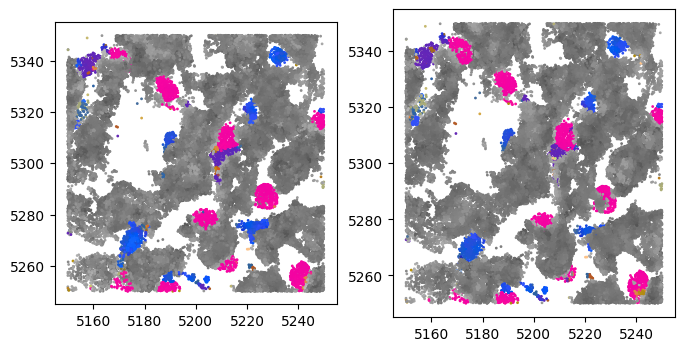

In [49]:
for i in range(2,len(x_highlights)):
    
    x = x_highlights[i][0]+(x_highlights[i][1]-x_highlights[i][0])/2
    y = y_highlights[i][0]+(y_highlights[i][1]-y_highlights[i][0])/2
    
    subsample = visualizer.subsample_df(x,y,coordinate_df=coordinate_df,window_size=200)
    
    subsample_embedding,subsample_rgb = colorize_liver(subsample)
    
    subsample_z_order = subsample.z.argsort()
    
    plt.figure(figsize=(8,4))
    
    plt.subplot(121)
    
    plt.scatter(x=subsample.x.iloc[subsample_z_order],y=subsample.y.iloc[subsample_z_order],c=subsample_rgb[subsample_z_order],s=1)
    
    plt.gca().set_aspect('equal')
    
    plt.subplot(122)
    
    plt.scatter(x=subsample.x.iloc[subsample_z_order[::-1]],y=subsample.y.iloc[subsample_z_order[::-1]],c=subsample_rgb[subsample_z_order[::-1]],s=1)
    
    plt.gca().set_aspect('equal')
    
    plt.savefig(f'./publication/vizgen-liver/figures/liver_highlight_stromal_{i+1}.svg',dpi=300)

### Show cutout around a duct:

We can zoom in closer to a ductal cell to better visualize the apparent slicing effects happening there:

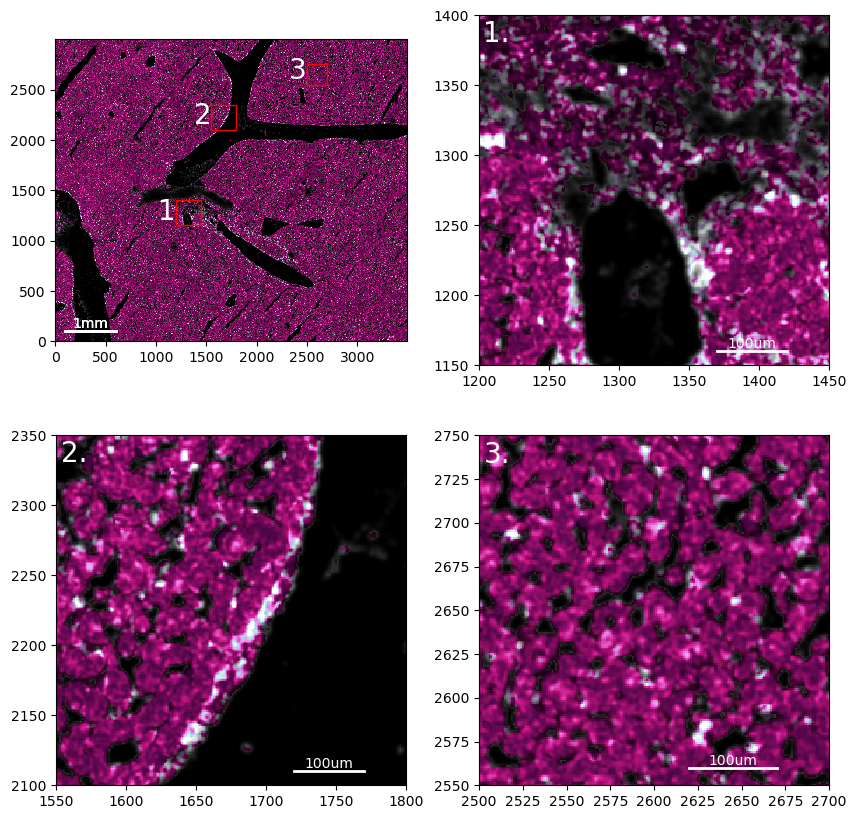

In [19]:
from src.utils import plot_scalebar
import matplotlib.pyplot as plt

plt.figure(figsize=(10,10))

xlims = [[0,300],[1200,1450],[1550,1800],[2500,2700]]
ylims = [[1300,1350],[1150,1400],[2100,2350],[2550,2750]]

for i in range(4):
    ax=plt.subplot(2,2,i+1,facecolor='k')

    plot_coherence(coherence_.T,signal_.T,signal_cutoff=10,ax=ax)
    # plt.colorbar()

    if i==0:
        
        for j in range(1,4):
            rect = plt.Rectangle((xlims[j][0],ylims[j][0]),xlims[j][1]-xlims[j][0],ylims[j][1]-ylims[j][0],linewidth=1,edgecolor='r',facecolor='none')
            ax.add_patch(rect)
            
            txt = plt.text(xlims[j][0],ylims[j][0],f'{j}',color='w',fontsize=20,ha='right',va='bottom')
            
            plot_scalebar(ax,100,100,500,text='1mm',color='w',edge_color=None)
            
            ax.invert_yaxis()
            
            # break

        
    else:

        text = plt.text(xlims[i][0]+3,ylims[i][1]-3,f'{i}.',color='w',fontsize=20,ha='left',va='top')
        plt.xlim(*xlims[i])
        plt.ylim(*ylims[i])
        
        plot_scalebar(ax,xlims[i][1]-80,ylims[i][0]+10,50,text='100um',color='w',edge_color=None)
        
        # ax.invert_yaxis()
        
    # plt.xticks([])
    # plt.yticks([])
    
    # ax.cla()
        
plt.savefig('./manuscript/figures/results/vizgen-liver/slicing-artifact-cases.svg',dpi=300)

In [18]:
fold_df_bottom

NameError: name 'fold_df_bottom' is not defined

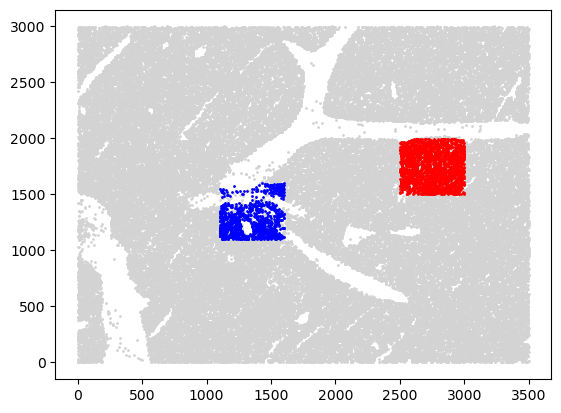

In [20]:

# crop out a central part of the tissue to create artificial overlaps:
xb_,_xb,yb_,_yb = 2500,3000,1500,2000
xt_,_xt,yt_,_yt = 1100,1600,1100,1600
fold_bottom_mask = df.x.between(xb_,_xb)&df.y.between(yb_,_yb)
fold_top_mask = df.x.between(xt_,_xt)&df.y.between(yt_,_yt)

fold_df_bottom = df[fold_bottom_mask].copy()
fold_df_bottom['fold'] = 'bottom'
fold_df_top = df[fold_top_mask].copy()
fold_df_top['fold'] = 'top'

plt.scatter(df.x[::1000],df.y[::1000],c='lightgrey',s=1)
plt.scatter(fold_df_bottom.x[::1000],fold_df_bottom.y[::1000],c='r',s=1)
plt.scatter(fold_df_top.x[::1000],fold_df_top.y[::1000],c='b',s=1)

# move the signal to origin
fold_df_bottom.x-=xb_
fold_df_top.x-=xt_

fold_df_bottom.y-=yb_
fold_df_top.y-=yt_

ovrlp.assign_xy(fold_df_bottom)
ovrlp.assign_xy(fold_df_top)

ovrlp.assign_z_mean(fold_df_bottom)
ovrlp.assign_z_mean(fold_df_top)

fold_df_folded = fold_df_bottom.copy()
fold_df_folded.z-=fold_df_bottom.z.max()-fold_df_top.z.min()
fold_df_folded = pd.concat([fold_df_folded,fold_df_top])

ovrlp.assign_xy(fold_df_folded)
ovrlp.assign_z_mean(fold_df_folded)

fold_bottom_centroids = pd.DataFrame.from_dict({'x':visualizer.rois_celltyping_x,'y':visualizer.rois_celltyping_y})
fold_top_centroids = pd.DataFrame.from_dict({'x':visualizer.rois_celltyping_x,'y':visualizer.rois_celltyping_y})

fold_bottom_centroids = fold_bottom_centroids[fold_bottom_centroids.x.between(xb_,_xb-1)&fold_bottom_centroids.y.between(yb_,_yb-1)]
fold_bottom_centroids.x-=xb_
fold_bottom_centroids.y-=yb_

fold_top_centroids = fold_top_centroids[fold_top_centroids.x.between(xt_,_xt-1)&fold_top_centroids.y.between(yt_,_yt-1)]
fold_top_centroids.x-=xt_
fold_top_centroids.y-=yt_


[  0 500] [  0 500]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.33s/it]


[  0 500] [  0 500]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.39s/it]


[  0 500] [  0 500]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.90s/it]


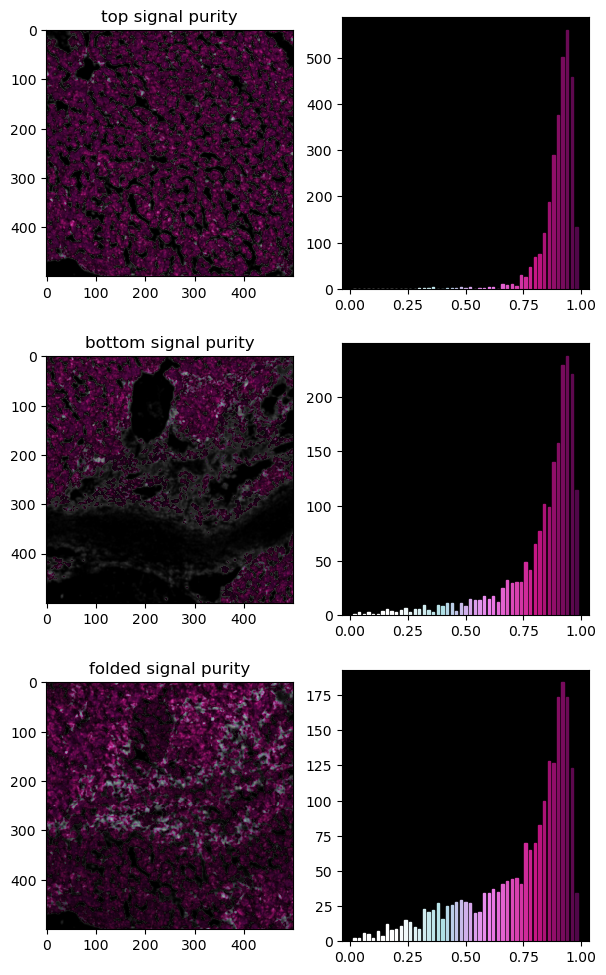

In [21]:
from matplotlib.colors import LinearSegmentedColormap

min_expression=5

cmap = LinearSegmentedColormap.from_list('', ['#430541','mediumvioletred','violet','powderblue','white','white'][::-1])

coherence_bottom, signal_bottom = ovrlp.compute_divergence_patched(fold_df_bottom, visualizer.genes, visualizer.pca_2d.components_,
    KDE_bandwidth=1, min_expression=min_expression, patch_length=500)

coherence_top, signal_top = ovrlp.compute_divergence_patched(fold_df_top, visualizer.genes, visualizer.pca_2d.components_,
    KDE_bandwidth=1, min_expression=min_expression, patch_length=500)

coherence_folded, signal_folded = ovrlp.compute_divergence_patched(fold_df_folded, visualizer.genes, visualizer.pca_2d.components_,
    KDE_bandwidth=1, min_expression=min_expression, patch_length=500)

def plot_purity_distribution(coherence,ax=None):
    if ax is None:
        ax = plt.gca()
    vals,bins = np.histogram(coherence, bins=50, range=(0,1))
    colors = cmap(bins[1:-1])
    bars = ax.bar(bins[1:-1],vals[1:],width=0.01)
    for i,bar in enumerate(bars):
        bar.set_color(colors[i])

fig = plt.figure(figsize=(7,12))

ax = plt.subplot(321,facecolor='k')
plt.title('top signal purity')
plt.imshow(coherence_bottom.T**1, cmap=cmap, vmin= 0.0, vmax=1.0, alpha = signal_bottom.T/signal_bottom.max(), interpolation='nearest')
ax = plt.subplot(322,facecolor='k')
plot_purity_distribution(coherence_bottom[fold_bottom_centroids.x,fold_bottom_centroids.y],ax=ax)

ax = plt.subplot(323,facecolor='k')
plt.title('bottom signal purity')
plt.imshow(coherence_top.T**1, cmap=cmap, vmin= 0.0, vmax=1.0, alpha = signal_top.T/signal_top.max(), interpolation='nearest')
ax = plt.subplot(324,facecolor='k')
plot_purity_distribution(coherence_top[fold_top_centroids.x,fold_top_centroids.y],ax=ax)


ax = plt.subplot(325,facecolor='k')
plt.title('folded signal purity')
plt.imshow(coherence_folded.T**1, cmap=cmap, vmin= 0.0, vmax=1.0, alpha = signal_folded.T/signal_folded.max(), interpolation='nearest')
ax = plt.subplot(326,facecolor='k')
plot_purity_distribution(coherence_folded[fold_top_centroids.x,fold_top_centroids.y],ax=ax)



/tmp/ipykernel_2576320/1395931731.py:4: RuntimeWarning: divide by zero encountered in true_divide
  hist_quotient = hist_folded/hist_bottom


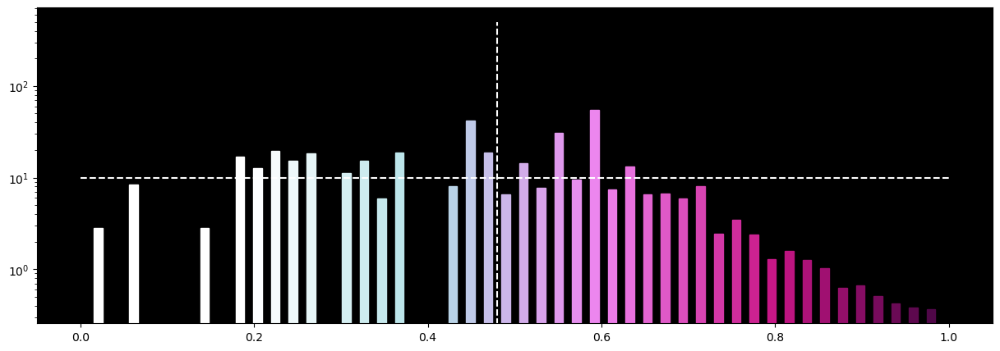

In [22]:
hist_top, bins,  = np.histogram(coherence_top[fold_top_centroids.x,fold_top_centroids.y],bins=np.linspace(0,1,50),density=True)
hist_bottom, bins,  = np.histogram(coherence_bottom[fold_bottom_centroids.x,fold_bottom_centroids.y],bins=np.linspace(0,1,50),density=True)
hist_folded, bins,  = np.histogram(coherence_folded[fold_top_centroids.x,fold_top_centroids.y],bins=np.linspace(0,1,50),density=True)
hist_quotient = hist_folded/hist_bottom

plt.figure(figsize=(15,5))

ax = plt.subplot(111,facecolor='k')
colors = cmap(bins[1:-1])
bars = ax.bar(bins[1:-1],hist_quotient[1:],width=0.01)
for i,bar in enumerate(bars):
    bar.set_color(colors[i])
    
ax.set_yscale('log')
plt.hlines(10,0,1,linestyles='dashed',color='w')
plt.vlines(0.48,0,500,linestyles='dashed',color='w')

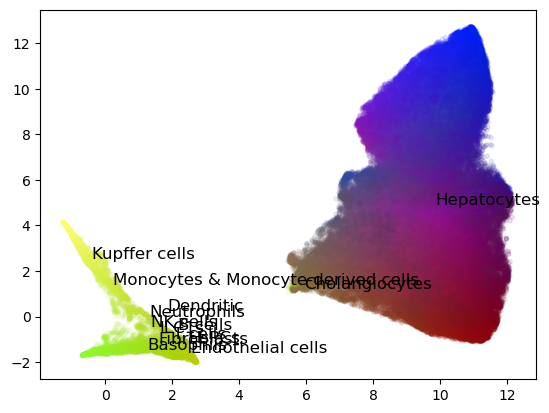

In [23]:
visualizer.plot_umap()

### June updates:

#### vizgen liver:
- smaller sampling area, higher sampling resolution
- refined cell typing map. Layering in ductal coatings is now finally visible.
- 

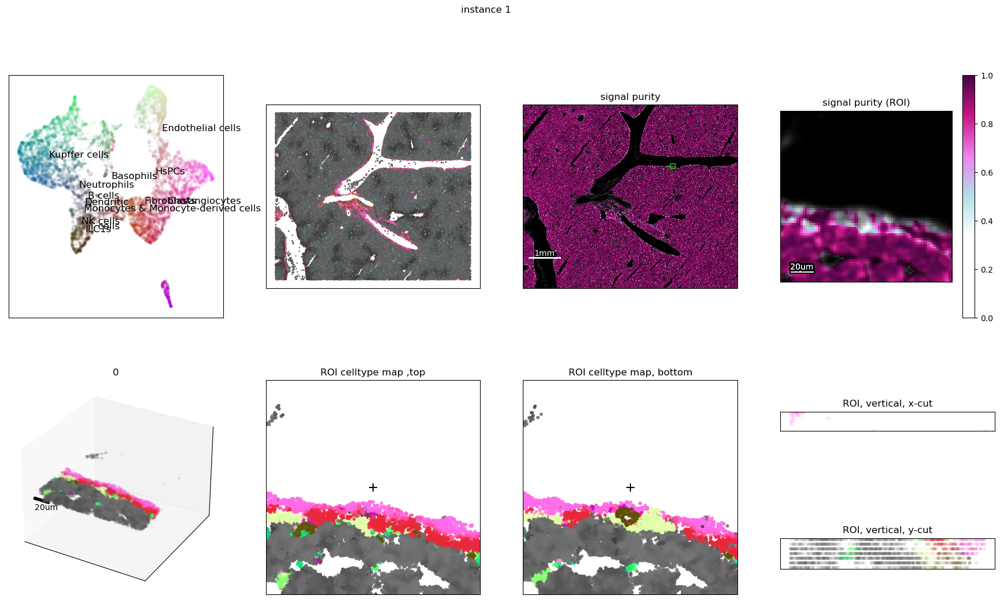

In [25]:
import matplotlib.patches as patches
from src.utils import plot_scalebar
import random

# window_size = 100
window_size = 40

for n in range(0,1):

    random.seed(42)

    signal__ = signal_.copy()
    signal__ [signal__>40]=40
    signal__[signal__<5]=0
    signal__/=signal__.max()

    # y,x = 1700,1150#dist_x[n],dist_y[n]
    # y,x = 50,200#dist_x[n],dist_y[n]
    # y,x = 1400,1700#dist_x[n],dist_y[n]
    # y,x = 520,2450#dist_x[n],dist_y[n]
    # y,x = 800,400#dist_x[n],dist _y[n]
    # y,x = 2000,2050
    # y,x = (790, 1900)
    y,x = 1000,1000
    y,x = 2000,2440
    # y,x = dist_x[n],dist_y[n]
    # y,x = np.mean(ylims[n+1]),np.mean(xlims[n+1])

    subsample = visualizer.subsample_df(x,y,df,window_size=window_size)    
    subsample_embedding, subsample_embedding_color = colorize_liver(subsample)

    visualizer.plot_instance(subsample,subsample[['x','y']].values,subsample_embedding_color,x,y,window_size=window_size,rasterized=True)


    # print(f'instance visualizerualization runtime: {time.perf_counter()-perf_}')

    fig = plt.gcf()

    plt.suptitle(f'instance {n+1}')
    gs = (fig.get_axes()[0]).get_gridspec()

    ax =  fig.add_subplot(gs[0,2], facecolor='k')
    ax.set_title('signal purity')

    # ax.imshow(coherence_.T**10, cmap=cmap, vmin= 0.0, vmax=1.0, alpha = signal__.T, interpolation='nearest')
    plot_coherence(coherence_.T,signal_.T,signal_cutoff=10,ax=ax)

    ax.invert_yaxis()
    plot_scalebar(ax,100,500,500,text='1mm',color='w',edge_color=None)
    ax.set_xticks([])
    ax.set_yticks([])

    # Create a Rectangle patch
    rect = patches.Rectangle((x-window_size, y-window_size), window_size*2, window_size*2, linewidth=1, edgecolor='lime', facecolor='none')
    ax.add_patch(rect)

    ax = fig.add_subplot(gs[0,3], facecolor='k')
    ax.set_title('signal purity (ROI)')

    # plt.imshow(coherence_.T**5, cmap=cmap, vmin= 0.0, vmax=1.0, alpha = signal__.T, interpolation='nearest')
    plot_coherence(coherence_.T,signal_.T,signal_cutoff=10,ax=ax)
    plot_scalebar(ax,x-window_size+5,y-window_size+5,10,text='20um',color='w',edge_color='k')
    
    # plot_scalebar
    plt.colorbar()

    plt.xlim(x-window_size,x+window_size)
    plt.ylim(y-window_size,y+window_size) 
    ax.set_xticks([])
    ax.set_yticks([])
    
    scalebar_z_position = subsample.z.min()

    ax = fig.get_axes()[0]
    line_artist = ax.plot([x-window_size,x-window_size+10],[y-window_size,y-window_size],[scalebar_z_position,scalebar_z_position],c='k',lw=4)
    text_artist = ax.text(x-window_size+5,y-window_size+5,scalebar_z_position-6,'20um',fontsize=10,ha='center',va='top',c='k')
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_zticks([])

    ax.set_title('0')

    ax = fig.get_axes()[1]
    ax.cla()

    # print(ax)
    # utils.plot_embeddings(visualizer.embedding,global_liver_colors,visualizer.celltype_centers,visualizer.signatures.columns,rasterized=True,ax=ax)
    ovrlp.plot_embeddings(embedding,embedding_rgb,celltype_centers,signatures_without_hepatocytes.columns,ax=ax,rasterized=True)
    ax.set_xticks([])
    ax.set_yticks([])
    
    
    ax = fig.get_axes()[2]
    ax.cla()
    ax.scatter(visualizer.rois_celltyping_x,visualizer.rois_celltyping_y,c=global_liver_colors,s=1,rasterized=True)
    ax.set_xticks([])
    ax.set_yticks([])
    

    for a in [1,2,3,4,5,6]:
        ax = fig.get_axes()[a]
        ax.set_xticks([])
        ax.set_yticks([])
    
    plt.savefig(f'./manuscript/figures/results/vizgen-liver/showcase-{n}.svg',dpi=300)
 

In [ ]:

print(df.gene.cat.categories[df.gene.cat.categories.str.startswith('Lh')])

# fig=plt.figure(figsize=(40,40))
# ax=plt.subplot(111)

# df[::10].plot.scatter('x','y',s=2,color='k',ax=ax)
# df[df.gene.str.startswith('Cdh')].plot.scatter('x','y',color='r',s=2,ax=ax)

stellate_markers = ['Dach1','Fam19a1','Ntm','Hhip','Grin2b','Nrxn1','Lama1','Zfp804b','Bmp10','Colec11','Lsamp','Bmp5','Lrrc4c','Ngfr','Pth1r','Colec10','S1pr3','Nrxn3','Ptger2','Lhx2','Il34','Eya4',]

df.gene.cat.categories[df.gene.cat.categories.isin(stellate_markers)]
 

Index(['Lhfp'], dtype='object')


NameError: name 'kewl' is not defined

In [47]:
# 'Visg4' in df.gene.unique() 

# [g for g in df.gene.unique() if 's' in g]
print(sorted(df.gene.unique()))

['1700061G19Rik', 'Abcb4', 'Acaca', 'Acacb', 'Ace', 'Acsbg1', 'Acsbg2', 'Acsf3', 'Acsl1', 'Acsl4', 'Acsl5', 'Acsl6', 'Acss1', 'Acss2', 'Adgre1', 'Adh4', 'Adh7', 'Adpgk', 'Akap14', 'Akr1a1', 'Akr1c18', 'Akr1d1', 'Alas1', 'Alas2', 'Alcam', 'Aldh1b1', 'Aldh3a1', 'Aldh3a2', 'Aldh3b1', 'Aldh3b2', 'Aldh3b3', 'Aldh7a1', 'Aldoart1', 'Aldoart2', 'Aldoc', 'Ammecr1', 'Angpt1', 'Angpt2', 'Apobec3', 'Aqp1', 'Arsb', 'Axin2', 'B4galt6', 'Bank1', 'Bcam', 'Bmp2', 'Bmp5', 'Bmp7', 'Bpgm', 'Calcrl', 'Cald1', 'Cav2', 'Cbr4', 'Ccr1', 'Ccr2', 'Cd177', 'Cd300lg', 'Cd34', 'Cd44', 'Cd48', 'Cd83', 'Cd93', 'Cdh11', 'Cdh5', 'Cebpa', 'Celsr2', 'Chodl', 'Clec14a', 'Cnp', 'Col1a2', 'Col6a1', 'Comt', 'Csf1r', 'Csf3r', 'Csk', 'Csnk1a1', 'Cspg4', 'Ctnnal1', 'Ctsc', 'Cxadr', 'Cxcl12', 'Cxcl14', 'Cxcr2', 'Cybb', 'Cygb', 'Cyp11a1', 'Cyp11b1', 'Cyp17a1', 'Cyp1a1', 'Cyp1a2', 'Cyp21a1', 'Cyp2b19', 'Cyp2b23', 'Cyp2b9', 'Cyp2c23', 'Cyp2c38', 'Cyp2c55', 'Cyp7b1', 'Ddx4', 'Dek', 'Dkk1', 'Dkk2', 'Dkk3', 'Dlat', 'Dld', 'Dll1', 'Dll

In [92]:
len(genes)

347

ValueError: alpha must be between 0 and 1, inclusive, but min is nan, max is nan

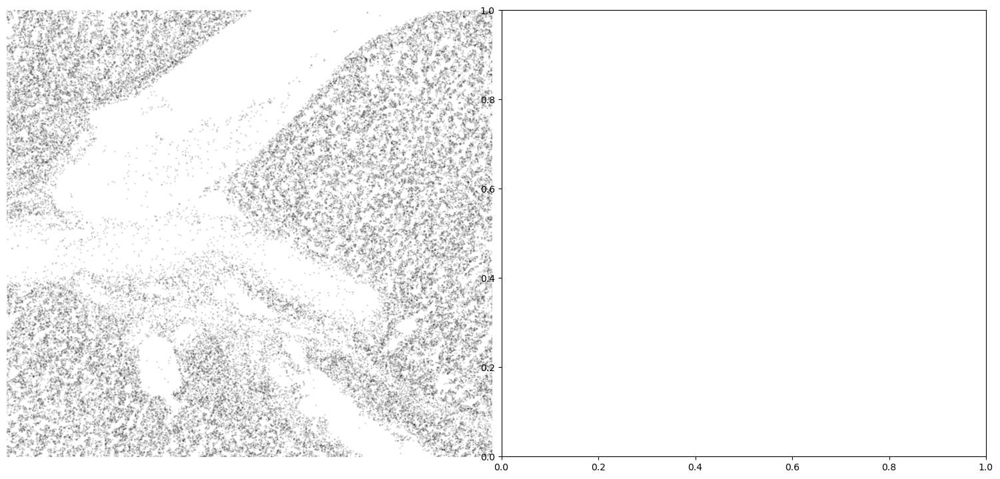

In [109]:
plt.figure(figsize=(15,7))

marker_genes = {
    'smooth_muscle': ['Myh10', 'Acta2', 'Cnn1', 'Cald1', 'Tagln'],
    'fibroblast': ['Pdgfra', 'Col1a2', 'Dpt', 'Fstl1', 'Lox'],
    'endothelial': ['Pecam1', 'Cdh5', 'Tek', 'Kdr', 'Clec14a'],
    'Kupffer': ['Adgre1', 'Mrc1', 'Csf1r', 'C1qa', 'Itgam'],
    'stellate': ['Lrat', 'Gfap', 'Cygb', 'Col1a2', 'Pdgfrb'],
    'cholangiocyte': ['Epcam', 'Krt19', 'Aqp1', 'Sox9', 'Cftr'],
    'sinusoid': ['Lyve1', 'Stab2', 'Vcam1', 'Clec14a', 'Eng']
}


markers = ['Acta2']#marker_genes['sinusoid']

ax1 = plt.subplot(121)
ax1.scatter(df.x[::100],df.y[::100],c='k',s=1,alpha=0.1)
ax1.scatter(df.x[df.gene.isin(markers)],df.y[df.gene.isin(markers)],c='r',s=1,alpha=0.1)
plt.axis('off')
plt.tight_layout()

plt.xlim(1000,2000)
plt.ylim(1000,2000)

plt.subplot(122)

# marker_mask = visualizer.genes.isin(markers)*2
# alpha = visualizer.localmax_celltyping_samples.T@marker_mask
# alpha-=alpha.min()
# alpha/=alpha.max()

# plt.scatter(visualizer.embedding[:,0],visualizer.embedding[:,1],c=visualizer.colors,s=1,alpha=alpha,)


marker_mask = visualizer.genes.isin(markers)
alpha = (local_expression)@marker_mask
alpha-=alpha.min()
alpha/=alpha.max()

plt.scatter(embedding[:,0],embedding[:,1],c=embedding_rgb,s=10,alpha=alpha,)
plt.axis('off')


         Falling back to preprocessing with `sc.pp.pca` and default params.


/tmp/ipykernel_1982128/1388034688.py:6: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_visualizer = anndata.AnnData(X=visualizer.localmax_celltyping_samples.T.iloc[~global_hepatocyte_mask])#,var=visualizer.genes)


/home/tiesmeys/miniconda3/envs/spatial2022/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


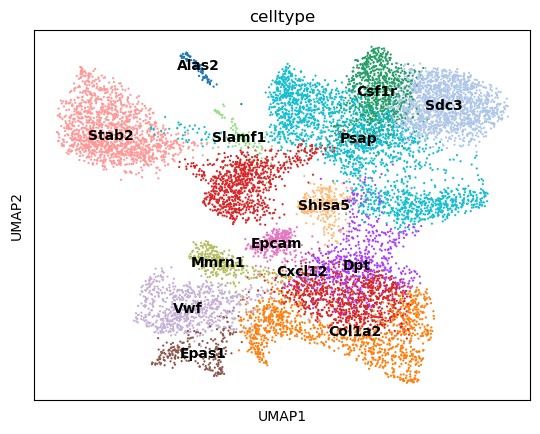

Celltype Psap:
Celltype Cxcl12:
Celltype Stab2:
Celltype Sdc3:
Celltype Csf1r:
Celltype Shisa5:
Celltype Epcam:
Celltype Vwf:
Celltype Slamf1:
Celltype Dpt:
Celltype Alas2:
Celltype Col1a2:
Celltype Mmrn1:
Celltype Epas1:


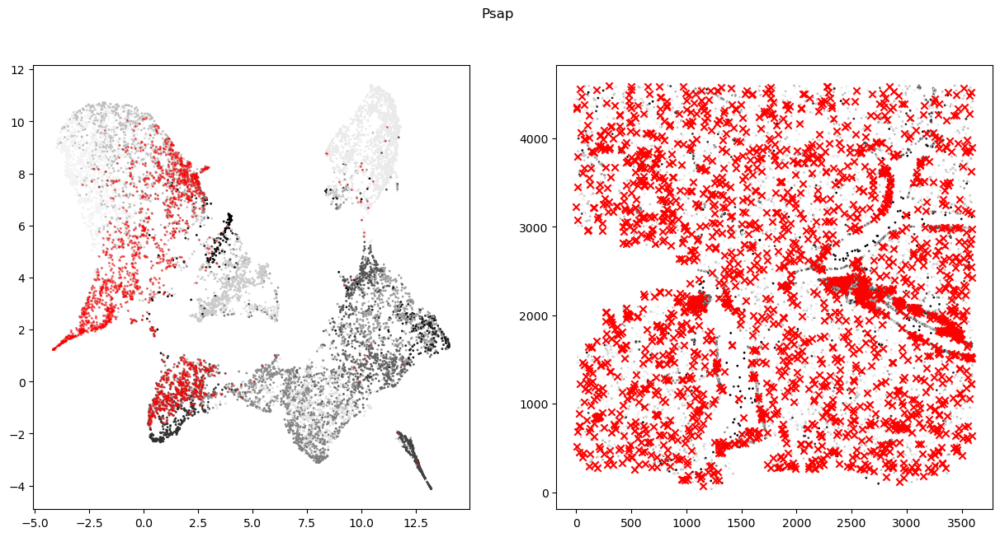

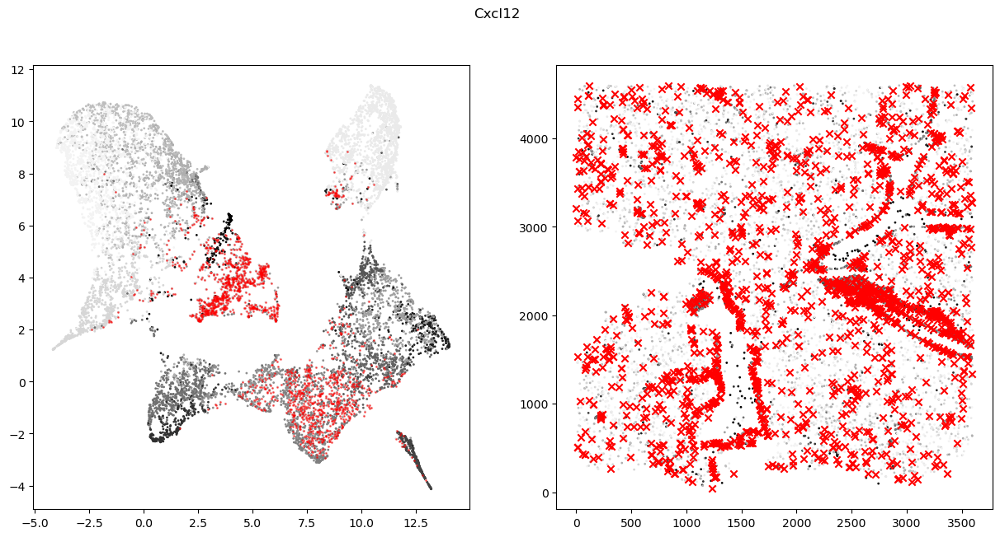

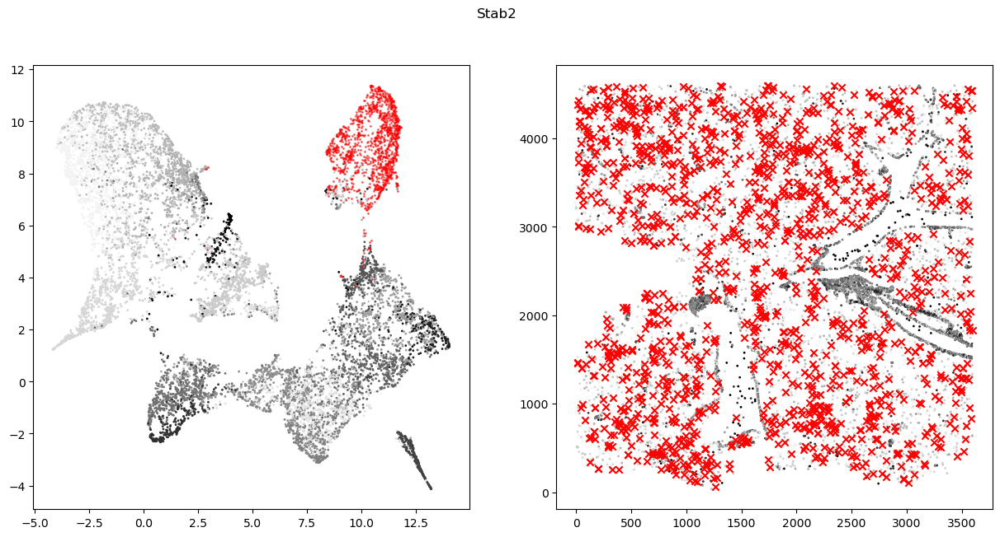

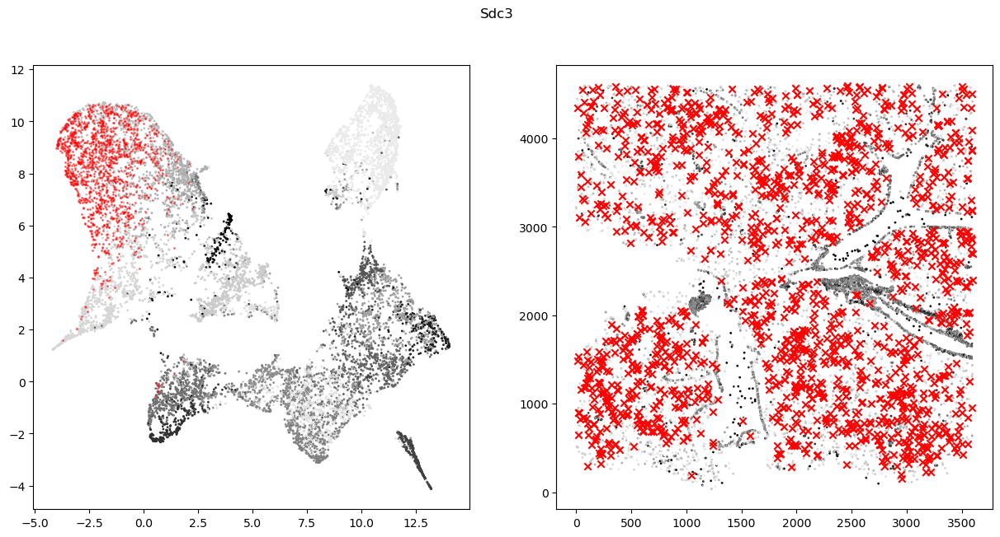

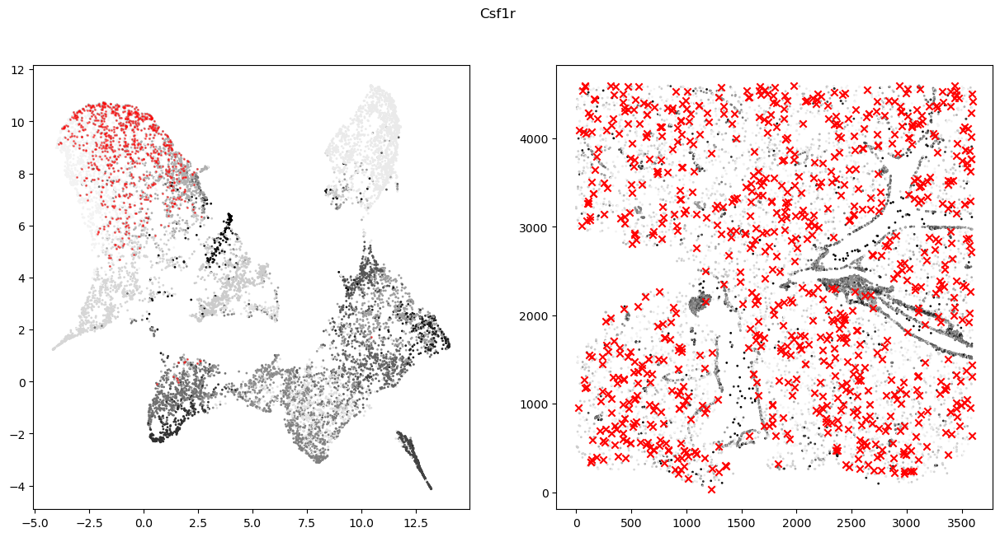

...

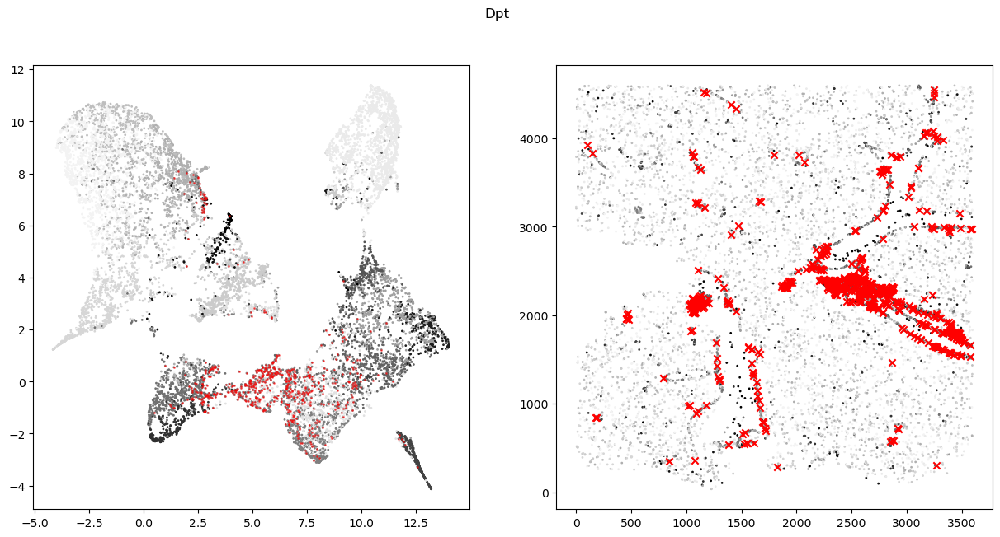

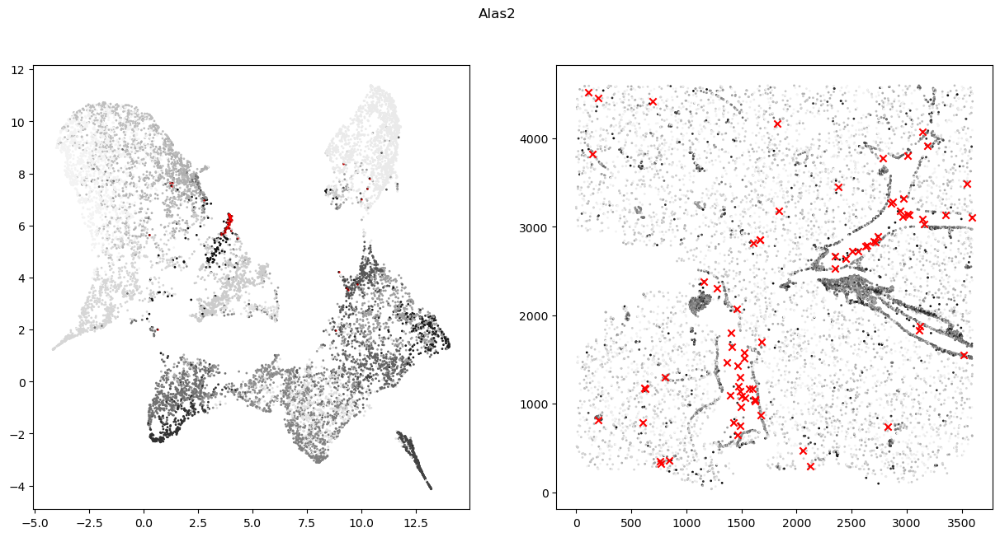

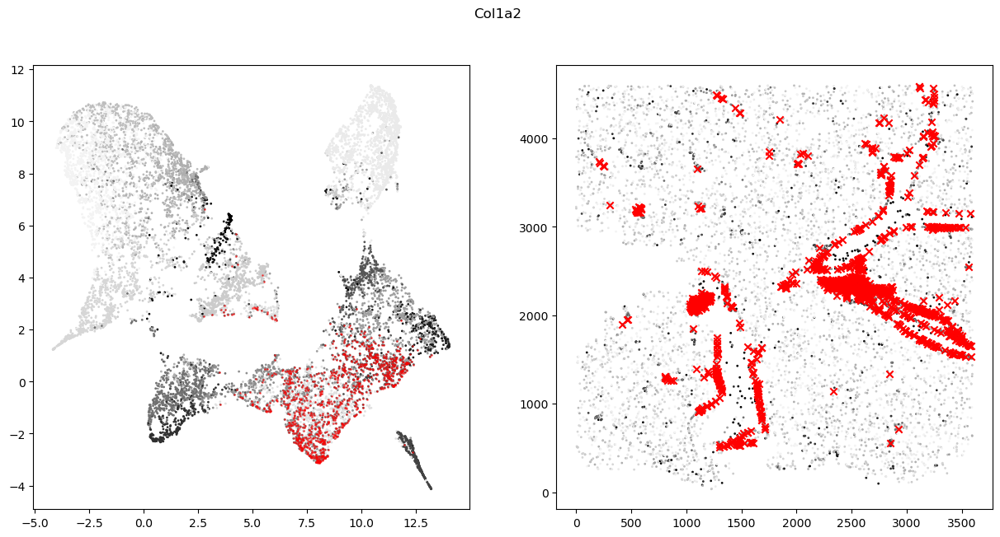

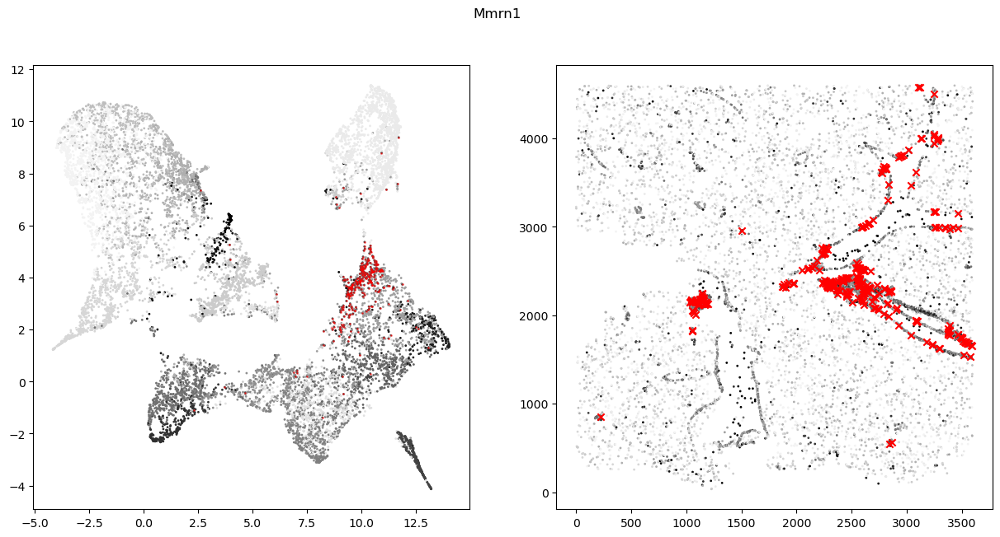

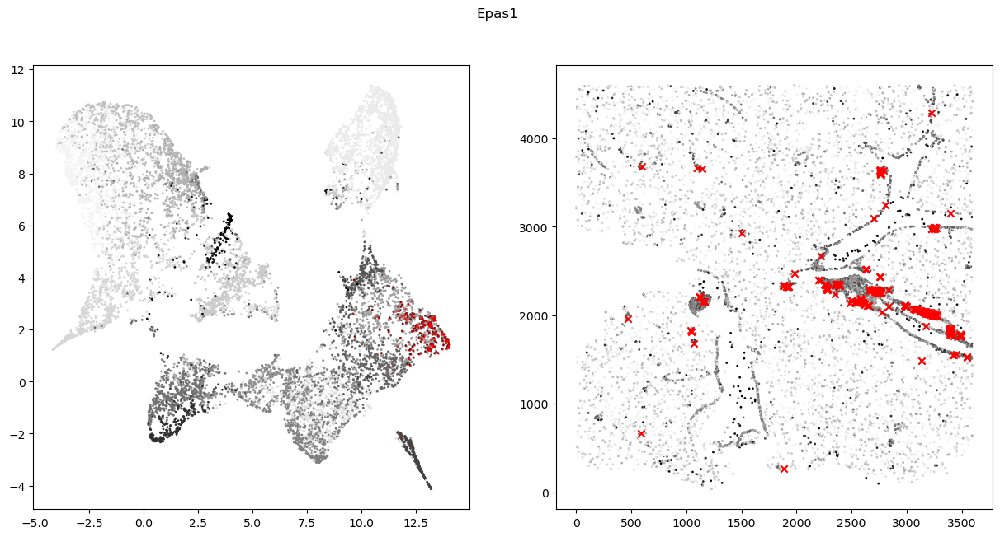

In [ ]:
import scanpy as sc
import anndata
# import scanpy as sc
from matplotlib.lines import Line2D

adata_visualizer = anndata.AnnData(X=visualizer.localmax_celltyping_samples.T.iloc[~global_hepatocyte_mask])#,var=visualizer.genes)

## we want to do a clustering, embedding and marker gene selection:

sc.pp.neighbors(adata_visualizer, n_neighbors=20, n_pcs=30)

sc.tl.umap(adata_visualizer)

sc.tl.leiden(adata_visualizer, resolution=1.5)

# Assuming your AnnData object is named adata_visualizer
sc.tl.rank_genes_groups(adata_visualizer, groupby='leiden')

# assign celltype to clusters by correlation analysis with signatures:
adata_visualizer.obs['celltype']='unknown'

for i,cluster in enumerate(adata_visualizer.obs.leiden.cat.categories):
    cluster_expression = adata_visualizer[adata_visualizer.obs.leiden==cluster].X.toarray().mean(0)
    correlations = signatures_without_hepatocytes.apply(lambda x: x.corr(pd.Series(cluster_expression,index=adata_visualizer.var.index)))
    
    adata_visualizer.obs.loc[adata_visualizer.obs.leiden==cluster,'celltype'] = correlations.idxmax()
    
adata_visualizer.obs
# Access the results
result = adata_visualizer.uns['rank_genes_groups']
# Get the marker genes for each cluster
marker_genes = result['names']

# Get the scores for each marker gene
marker_scores = result['scores']

# Get the cluster labels
cluster_labels = result['names'].dtype.names


sc.pl.umap(adata_visualizer, color='celltype',legend_loc='on data')

# Print each celltype:
for i,celltype in enumerate(adata_visualizer.obs.celltype.unique()):
    print(f"Celltype {celltype}:")
#     genes = marker_genes[cluster_label][:5]
#     scores = marker_scores[cluster_label][:5]
    
    plt.figure(figsize=(15,7))
    
    ax = plt.subplot(121)
    plt.scatter(*embedding.T,c=adata_visualizer.obs.leiden.cat.codes,cmap='Greys',s=1,vmin=-2)
    plt.scatter(*embedding[adata_visualizer.obs.celltype==celltype].T,color='r',s=1,alpha=0.5)
    
    # custom_legend_elements = [Line2D([0], [0], lw=1, label=f"{gene} : {score:2.1f}") for gene, score in zip(genes, scores)]
#     plt.legend(handles=custom_legend_elements)
    # ovrlp.plot_embeddings(embedding[adata_visualizer.obs.celltype==celltype],np.array([adata_visualizer.uns['leiden_colors'][i]]*(adata_visualizer.obs.leiden==cluster_label).sum()),celltype_centers,signatures_without_hepatocytes.columns,ax=ax,rasterized=True)
    
    ax = plt.subplot(122)
    plt.scatter(visualizer.rois_celltyping_x[~global_hepatocyte_mask],visualizer.rois_celltyping_y[~global_hepatocyte_mask],c=adata_visualizer.obs.leiden.cat.codes,cmap='Greys',s=1,vmin=-2)
    plt.scatter(visualizer.rois_celltyping_x[~global_hepatocyte_mask][adata_visualizer.obs.celltype==celltype],
                visualizer.rois_celltyping_y[~global_hepatocyte_mask][adata_visualizer.obs.celltype==celltype],
                c='r',marker='x')
    
    plt.suptitle(celltype)
    
        

    # break


(1000.0, 1500.0)

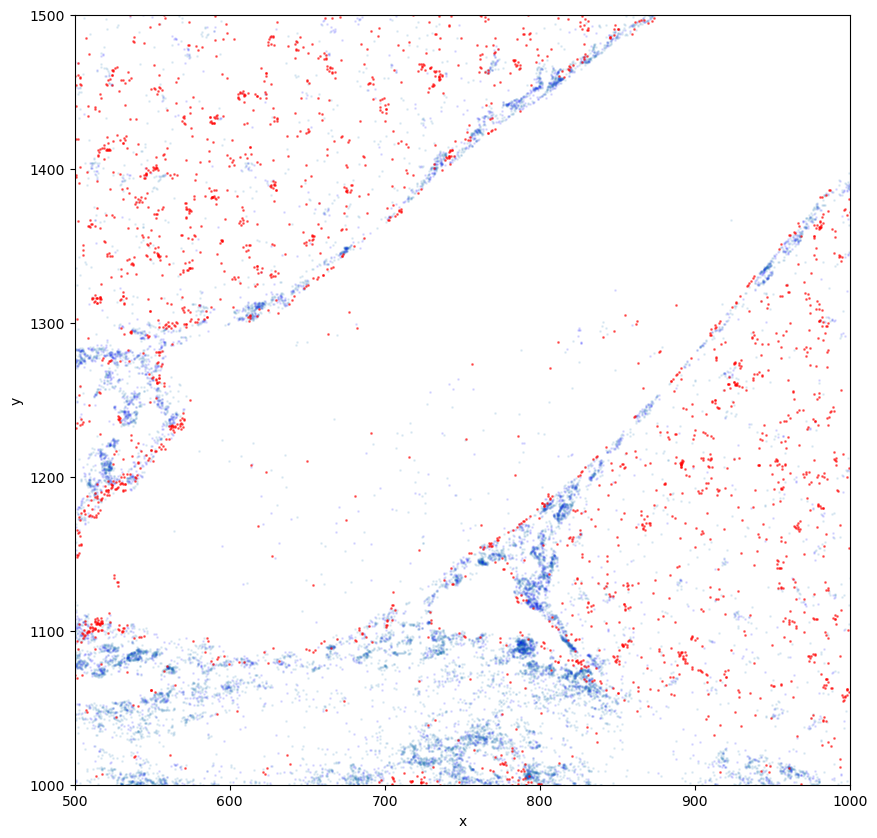

In [ ]:
plt.figure(figsize=(10,10))
ax=plt.subplot(111)

df[df.gene.str.startswith('Col1a2')].plot.scatter('x','y',s=1,ax=ax,alpha=0.1)
df[df.gene.str.startswith('Col6a1')].plot.scatter('x','y',s=1,ax=ax,alpha=0.1,c='b')
df[df.gene.str.startswith('Cdh5')].plot.scatter('x','y',s=1,ax=ax,alpha=0.5,c='r')


plt.xlim(500,1000)
plt.ylim(1000,1500)

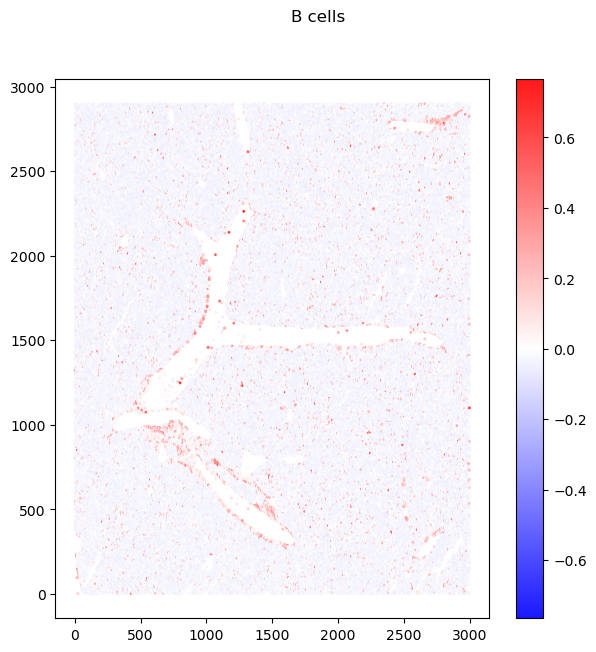

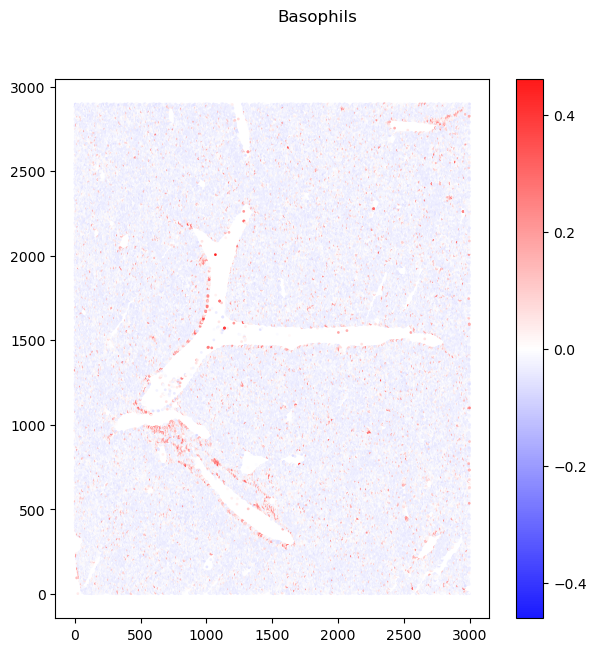

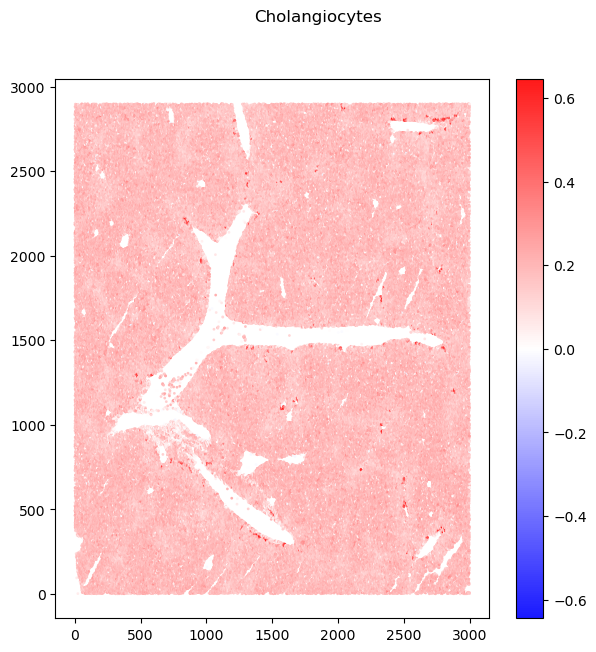

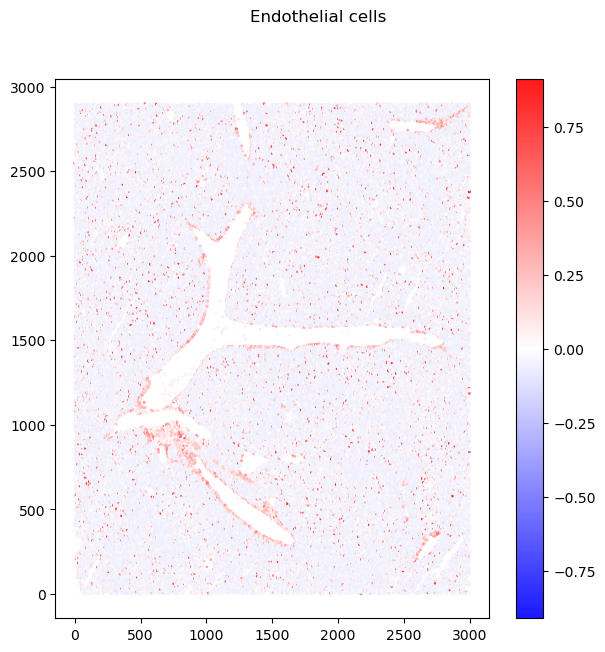

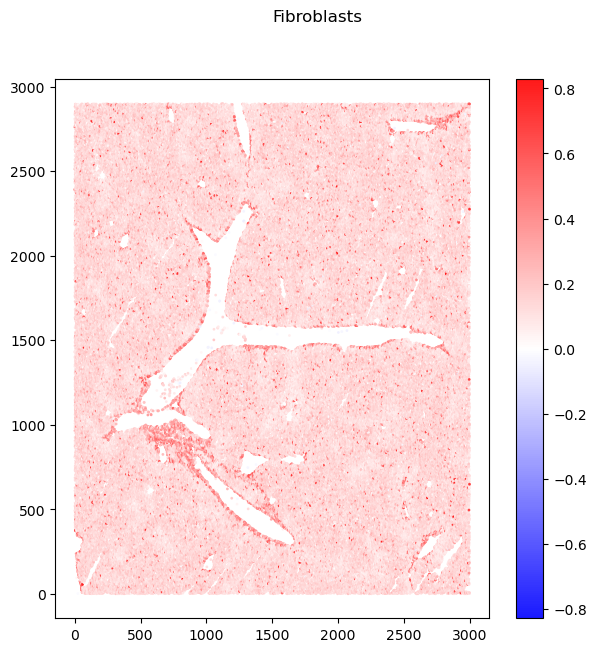

...

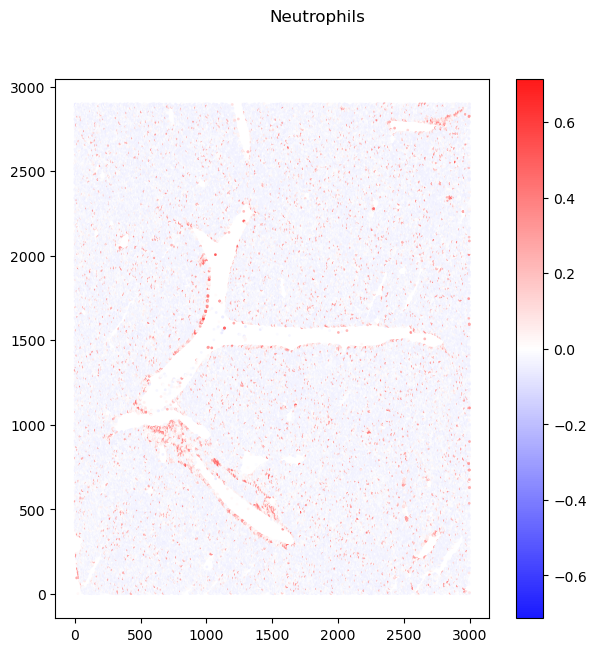

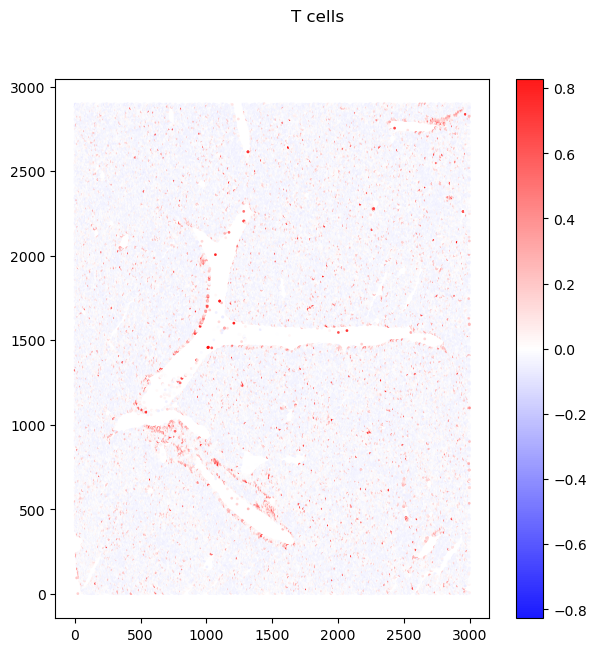

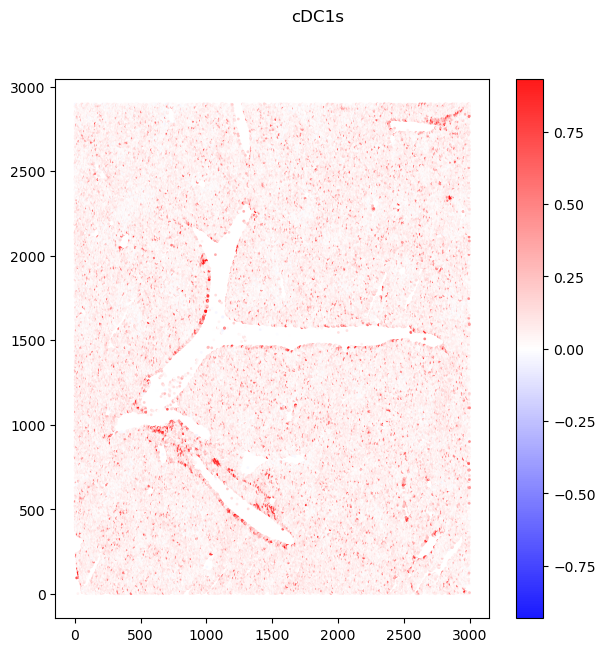

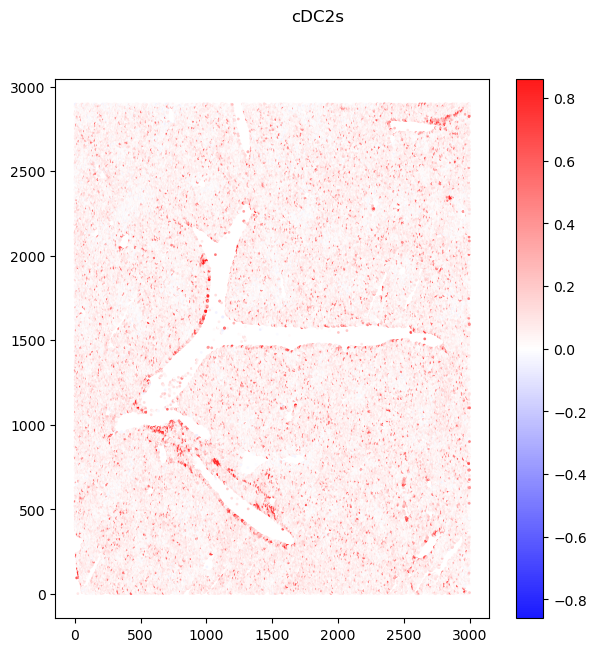

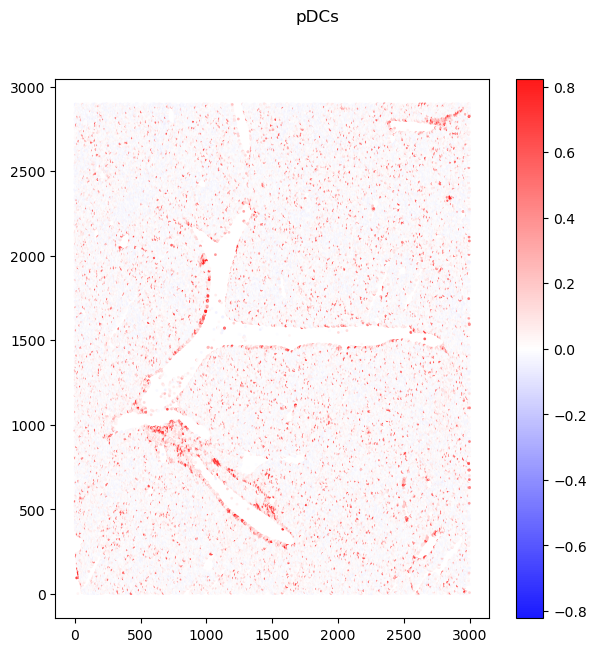

In [ ]:
import matplotlib.colors as mcolors

for i,celltype in enumerate(signatures.columns):

    cluster_expression = signatures.loc[:,celltype]
   
    correlations = visualizer.localmax_celltyping_samples.apply(lambda x: x.corr(cluster_expression))
    
    plt.figure(figsize=(7,7))
    plt.scatter(visualizer.rois_celltyping_x[:],visualizer.rois_celltyping_y[:],c=correlations[:],cmap='bwr',s=1,alpha=0.9,norm=mcolors.CenteredNorm())
    # plt.scatter(visualizer.rois_celltyping_x[~global_hepatocyte_mask][adata_visualizer.obs.celltype==celltype],
    #             visualizer.rois_celltyping_y[~global_hepatocyte_mask][adata_visualizer.obs.celltype==celltype],
                # c='r',marker='x')
    
    plt.suptitle(celltype)
    plt.colorbar()
    
    


In [ ]:
signatures.columns

Index(['B cells', 'Basophils', 'Cholangiocytes', 'Endothelial cells',
       'Fibroblasts', 'Hepatocytes', 'HsPCs', 'ILC1s', 'Kupffer cells',
       'Mig. cDCs', 'Monocytes & Monocyte-derived cells', 'NK cells',
       'Neutrophils', 'T cells', 'cDC1s', 'cDC2s', 'pDCs'],
      dtype='object')

In [ ]:

"""
#### Current project advances:

vizgen-liver
- we have a more fine-grained analysis that can recover endothelial cells, connective tissue and immune cells in both the mesenchyme and the parenchyme of the liver.
- we have many new prominent parenchymal cases of overlap 

xenium-brain
- we have produced an artificial fold, which might be used to determine a sensible threshold value;
- we have used the mapmycells tool to create cell type callings for the Xenium-segments
-- We can compare the quality of mapmycell callings (max correlation to signatures) to the ovrlpy scores at the same place
-- we can compare the top- and bottom mapmycell callings to see if the ovrlpy predictions of overlapping cells hold
-- we can compare the non-matching mapmycell callings to produce a confusion matrix of overlaps, and make statements about biology;

,leiden,celltype
6,5,Kupffer cells
29,1,Endothelial cells
30,1,Endothelial cells
32,8,Fibroblasts
71,1,Endothelial cells
...,...,...
170207,8,Fibroblasts
170208,4,Kupffer cells
170210,10,ILC1s
170219,8,Fibroblasts


In [ ]:
 


"""


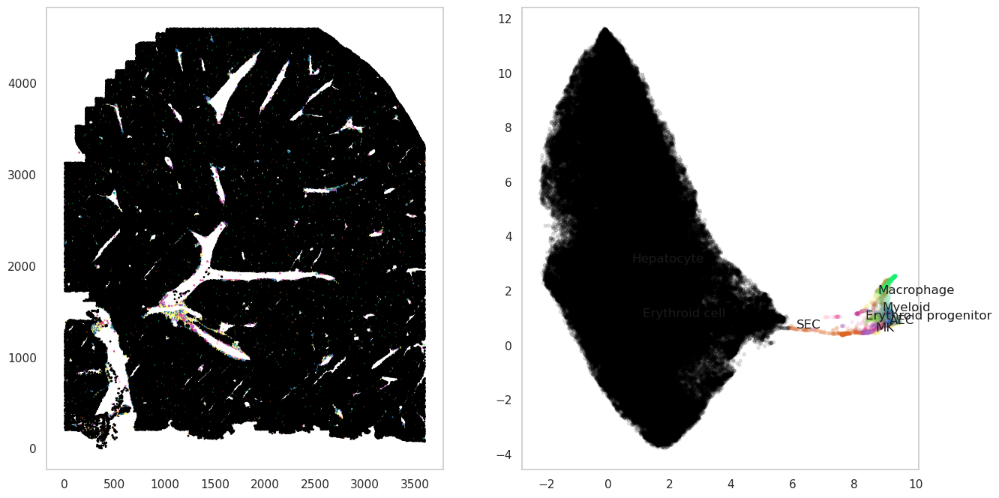

In [ ]:
leiden_colors = [adata_visualizer.uns['leiden_colors'][i] for i in adata_visualizer.obs.leiden.astype(int)]

leiden_rgb_array = np.array(['black' for i in range(len(global_hepatocyte_mask))])
leiden_rgb_array[~global_hepatocyte_mask] = leiden_colors

plt.figure(figsize=(15,8))

ax=plt.subplot(121)
plt.scatter(visualizer.rois_celltyping_x,visualizer.rois_celltyping_y,c=leiden_rgb_array,s=1,rasterized=True)

ax=plt.subplot(122)
ovrlp.plot_embeddings(visualizer.embedding,leiden_rgb_array,visualizer.celltype_centers,visualizer.signatures.columns,ax=ax,rasterized=True)

plt.savefig('./manuscript/figures/results/vizgen-liver/leiden_assignments.svg',dpi=300)

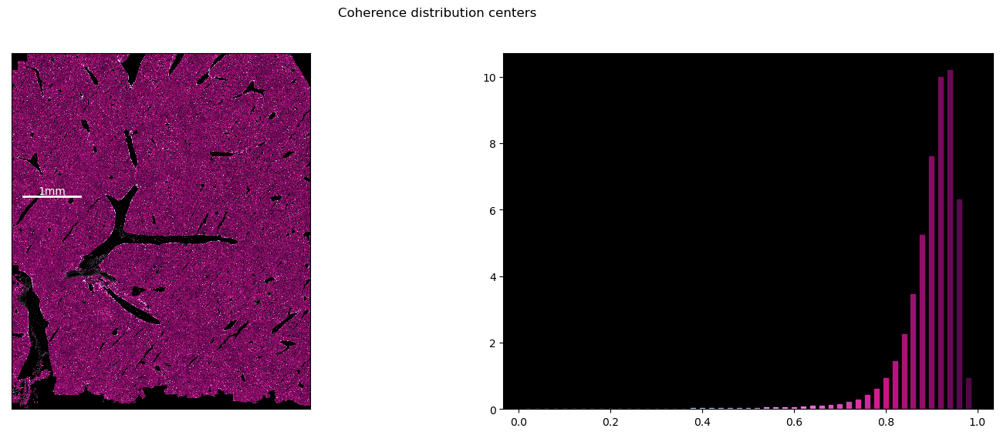

In [ ]:
import scipy
from matplotlib.cm import winter_r
from scipy.stats import beta

fig = plt.figure(figsize=(18,6))

plt.suptitle('Coherence distribution centers')

ax = fig.add_subplot(121,facecolor='k')

signal__ = signal_.copy()
signal__ [signal__>20]=20
signal__/=20

ax.imshow(coherence_.T, cmap=cmap, vmin= 0, vmax=1.0, alpha = signal__.T, interpolation='nearest')

coherence_at_localmax = coherence_[vis.rois_celltyping_x,vis.rois_celltyping_y]

vals,bins = np.histogram(coherence_at_localmax, bins=50, range=(0,1))
colors = cmap(bins[1:-1])

plt.xticks([])
plt.yticks([])
plt.gca().invert_yaxis()

plot_scalebar(plt.gca(),100,1850,500,text='1mm',color='w',edge_color=None)

ax1 = fig.add_subplot(122,facecolor='k')

# plt.plot(np.linspace(0,1,100),beta.pdf(np.linspace(0,1,100),a,b,loc,scale),color='lightgrey')
bars = plt.bar(bins[1:-1],vals[1:]/vals[1:].sum()*len(bins),width=0.01)

# plt.title('Beta fit to coherence at DAPI centers \n a={:.2f}, b={:.2f}, loc={:.2f}, scale={:.2f}'.format(a,b,loc,scale))

for i,bar in enumerate(bars):
    bar.set_color(colors[i])

plt.savefig('./manuscript/figures/results/vizgen-liver/coherence_distribution.svg',dpi=300)

  0%|                                                                                                                                                                                                                                                               | 0/1791 [00:02<?, ?it/s]


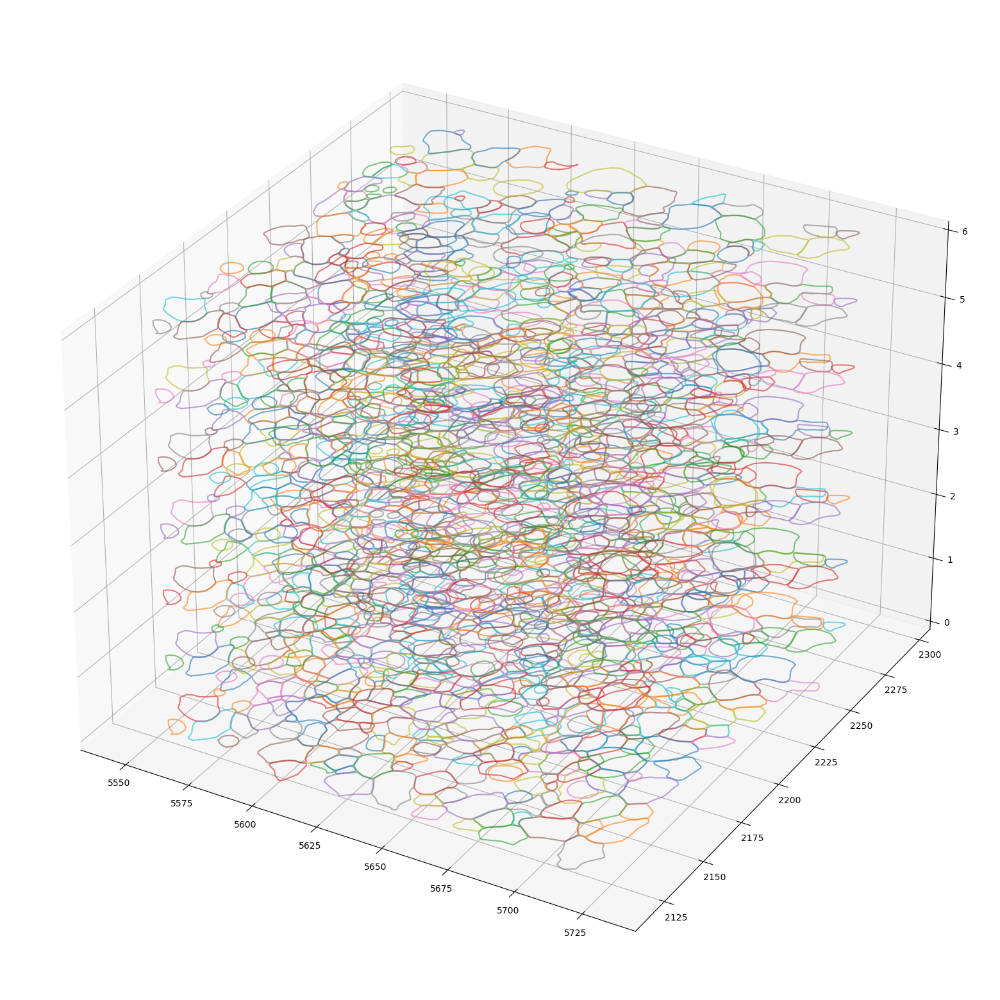

In [89]:

import h5py as h5
from shapely.geometry import Polygon
import rasterio
from rasterio.features import rasterize
import tqdm

# File_features = h5. "/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy/publication/vizgen-liver/mapmycells]$ ls /dh-projects/ag-ishaque/raw_data/vizgen-merfish/vz-liver-showcase/Liver{n_sample}Slice1/cell_boundaries"

polygons = [[] for i in range(12)]

max_x = 0
max_y = 0

cell_id = 0

files = os.listdir(f'/dh-projects/ag-ishaque/raw_data/vizgen-merfish/vz-liver-showcase/Liver{n_sample}Slice{n_slice}/cell_boundaries/')

for file in tqdm.tqdm(files,total = len(files)):
    with h5.File(f'/dh-projects/ag-ishaque/raw_data/vizgen-merfish/vz-liver-showcase/Liver{n_sample}Slice{n_slice}/cell_boundaries/{file}','r') as f:
        
        for i, features in enumerate (f['featuredata'].keys()):
            for j,idx_key in enumerate(f['featuredata'][features].keys()):
                
                if (isinstance(f['featuredata'][features][idx_key],h5.Dataset)):
                    # print(f['featuredata'][features][idx_key])
                    continue
                    # plt.plot(*f['featuredata'][features][idx_key]['coordinates'][0].T)

                else:
                    for m,p in enumerate(f['featuredata'][features][idx_key].keys()):                        
                        
                        polygon = Polygon(f['featuredata'][features][idx_key][p]['coordinates'][0]/(um_per_pixel/scale))
                        polygons[int(idx_key.split('_')[-1])].append((polygon, cell_id))  
                        
                        max_x = max(max_x,f['featuredata'][features][idx_key][p]['coordinates'][0][:,0].max()/(um_per_pixel/scale))
                        max_y = max(max_y,f['featuredata'][features][idx_key][p]['coordinates'][0][:,1].max()/(um_per_pixel/scale))
                        
                        # plt.plot(*f['featuredata'][features][idx_key][p]['coordinates'][0].T)
                        
            cell_id+=1
            

segmentation_maps = {i:rasterize(p, out_shape=(int(max_y+20),int(max_x+20)), fill=np.nan, all_touched=True, dtype=float) for i,p in enumerate(polygons) if len(p)>0}

overlaps = -np.ones_like(segmentation_maps[0])

for i,seg in segmentation_maps.items():
    overlap = (seg!=overlaps)&(overlaps!=-1)&(~np.isnan(seg))
    new_entry = (overlaps==-1)&(~np.isnan(seg))
    overlaps[overlap] = -2
    overlaps[new_entry] = seg[new_entry]

In [68]:
fig = plt.figure(figsize=(25,25))

# plt.imshow(segmentation_maps[0][slice(*y_lims),slice(*x_lims)]==segmentation_maps[2][slice(*y_lims),slice(*x_lims)])    

len(segmentation_maps)

7

<Figure size 2500x2500 with 0 Axes>

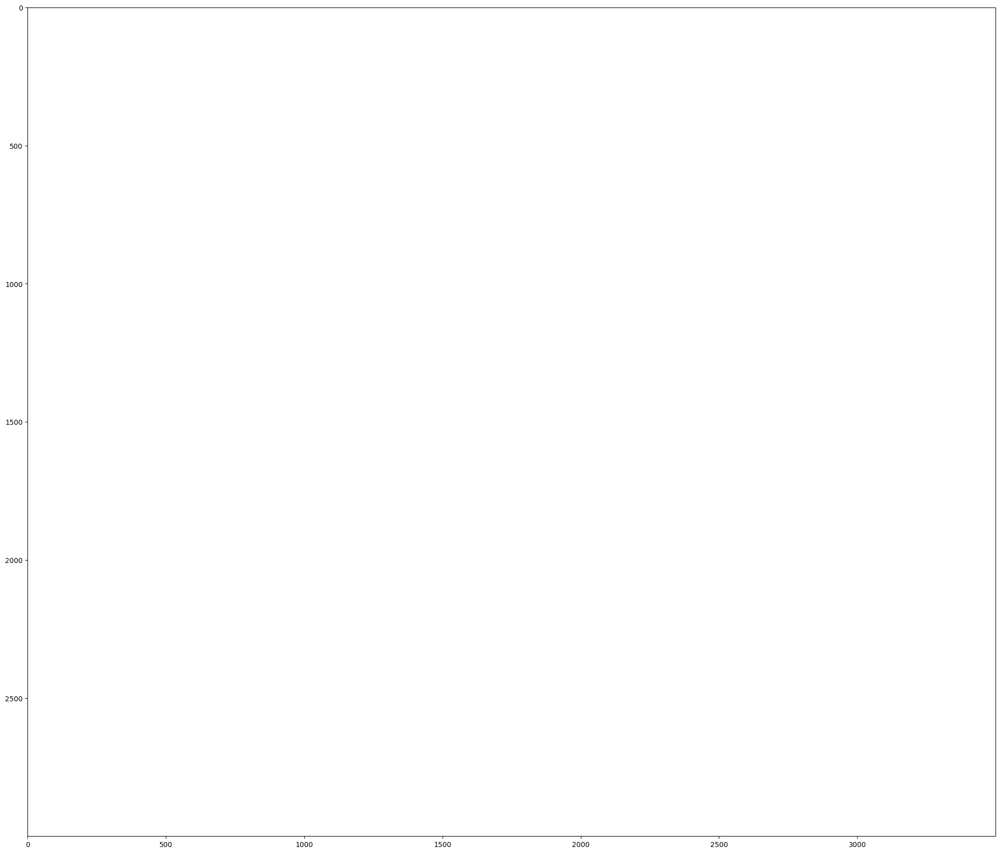

In [57]:
fig = plt.figure(figsize=(25,25))

ax = fig.add_subplot(111)
for i,seg in segmentation_maps.items():
    ax.imshow((seg>0),alpha=(segmentation_maps[0][slice(*y_lims),slice(*x_lims)]>0).astype(float)*0.02,vmin=0,vmax=1,cmap='Greys', interpolation='none')

# ax.imshow(overlaps[slice(*y_lims),slice(*x_lims)]==-2, cmap='magma_r', interpolation='none',alpha=(overlaps[slice(*y_lims),slice(*x_lims)]==-2).astype(float))


# plt.scatter(df.x[::1000],df.y[::1000],c='r',s=1)

# plt.ylim(1000,1200)
# plt.xlim(1000,1200)


In [ ]:
from scipy.stats import kstest

p_ks = kstest('beta',coherence_at_localmax[::2000],args=(a,b))

p_ks

KstestResult(statistic=1.0, pvalue=2.082103768164476e-12)

In [ ]:
# investigating variability within the non-hepatocyte clusters:

from sklearn.decomposition import PCA
from umap import UMAP

x_threshold = 4.0

local_expression = vis.localmax_celltyping_samples.T.loc[vis.embedding[:,0]<x_threshold]
local_expression = local_expression/((local_expression**2).sum(0)**0.5)

pca = PCA(n_components=10)
facs = pca.fit_transform(local_expression)

embedding = UMAP(n_components=2).fit_transform(facs)
embedder_3d = UMAP(n_components=3)
embedding3d = embedder_3d.fit_transform(facs)

embedding_small_rgb_min = embedding3d.min(axis=0)
embedding_small_rgb_max = embedding3d.max(axis=0)

embedding_rgb = embedding3d-embedding3d.min(axis=0)
embedding_rgb/=embedding_rgb.max(axis=0)

signatures_without_hepatocytes = signatures.iloc[:,~signatures.columns.str.contains('Hepatocyte')]

celltype_class_assignments = ovrlp.determine_celltype_class_assignments(local_expression.T,signatures_without_hepatocytes)
# signatures_without_hepatocytes.columns[celltype_class_assignments]
celltype_centers = np.array([np.median(embedding[celltype_class_assignments==i,:],axis=0) for i in range(len(signatures_without_hepatocytes.columns))])

celltype_centers

plt.figure(figsize=(20,8))

plt.subplot(121)
ovrlp.plot_embeddings(embedding,embedding_rgb,celltype_centers,signatures_without_hepatocytes.columns)

plt.subplot(122)
plt.scatter(vis.rois_celltyping_x,vis.rois_celltyping_y,c='grey',s=1)
plt.scatter(vis.rois_celltyping_x[vis.embedding[:,0]>x_threshold], 
            vis.rois_celltyping_y[vis.embedding[:,0]>x_threshold],c=embedding_rgb,s=2)


NameError: name 'vis' is not defined

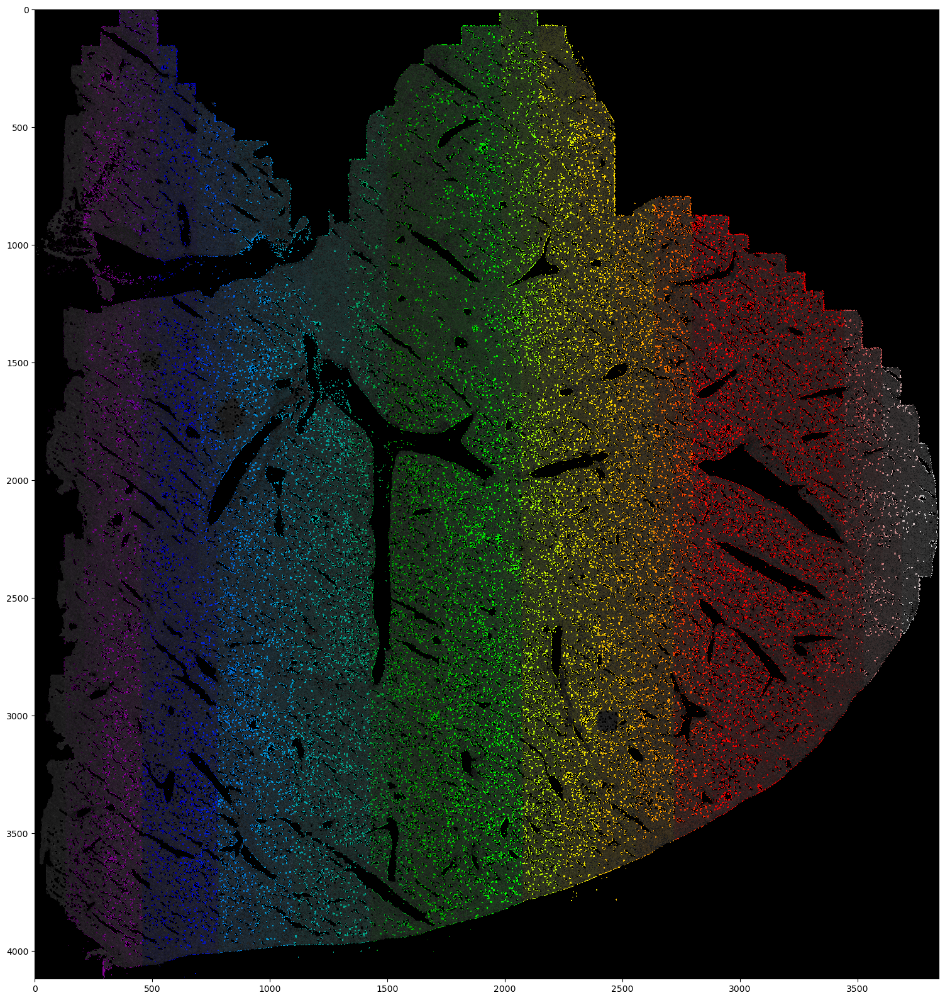

In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(segmentation_map,cmap='nipy_spectral',interpolation='none')

# plt.scatter(roi_df.y,roi_df.x,color='white',marker='x')
plt.imshow(incoherence,alpha=0.9,cmap='Greys')

/tmp/ipykernel_87381/4219698730.py:24: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  signatures = pd.DataFrame(index=adata_scrna_filtered.var.index,columns=celltypes).fillna(0)
/tmp/ipykernel_87381/4219698730.py:27: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[2.95391417e+00 1.10479794e-03 1.10479807e-02 4.41919267e-03
 6.62878808e-03 0.00000000e+00 4.26136423e-03 0.00000000e+00
 2.08333321e-02 3.46117437e-01 8.91729742e-02 3.42487395e-02
 7.89141399e-04 2.05176789e-03 0.00000000e+00 7.26010129e-02
 3.94570716e-02 1.68876275e-02 2.00441908e-02 2.03598458e-02
 5.68181882e-03 0.00000000e+00 3.44065689e-02 1.98863577e-02
 8.01767707e-02 2.09280312e-01 5.05050644e-03 1.89393957e-03
 0.00000

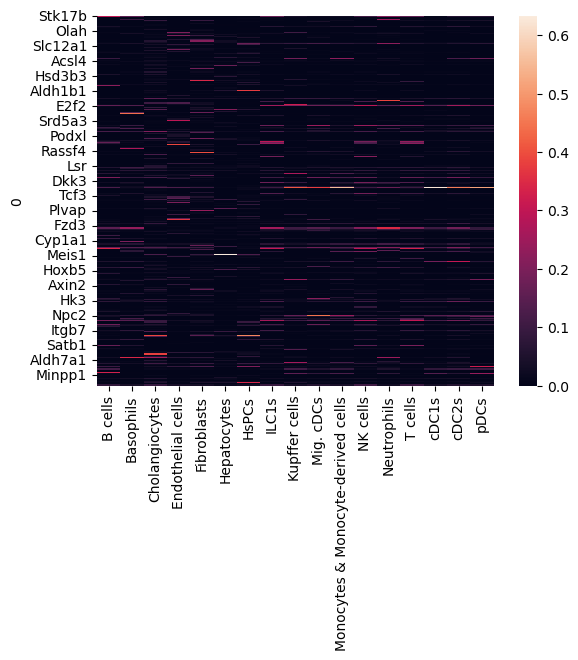

In [ ]:
import scanpy as sc
import pandas as pd
import scipy
import numpy as np

import seaborn as sns

scrna_annotations = pd.read_csv('./publication/vizgen-liver/rawData_mouseStSt/annot_mouseStStAll.csv')
feature_table = pd.read_csv('./publication/vizgen-liver/rawData_mouseStSt/countTable_mouseStSt/features.tsv',header=None,index_col=0)
barcodes = pd.read_csv('./publication/vizgen-liver/rawData_mouseStSt/countTable_mouseStSt/barcodes.tsv',header=None,index_col=0)
count_matrix = sc.read_mtx('./publication/vizgen-liver/rawData_mouseStSt/countTable_mouseStSt/matrix.mtx')

adata_scrna = sc.AnnData(X=count_matrix.X.T,var=feature_table,obs=barcodes)


del count_matrix

adata_scrna_filtered = adata_scrna[scrna_annotations.cell.values]
adata_scrna_filtered.obs = scrna_annotations

adata_scrna_filtered = adata_scrna_filtered[:,adata_scrna_filtered.var.index.isin(df.gene)]

celltypes = sorted(adata_scrna_filtered.obs.annot.unique())
signatures = pd.DataFrame(index=adata_scrna_filtered.var.index,columns=celltypes).fillna(0)

for i,celltype in enumerate(celltypes):
    signatures.loc[adata_scrna_filtered.var.index,celltype] = adata_scrna_filtered.X[adata_scrna_filtered.obs.annot==celltype].mean(0).A1
    
# signatures = signatures.loc[vis.genes]
signatures = np.log(1+signatures/((signatures**2).sum(0)**0.5))
sns.heatmap(signatures)

signatures.to_csv('./publication/vizgen-liver/signatures_liver_atlas.csv')

In [ ]:
from scipy.ndimage import gaussian_filter
expression_at_localmax_top = ovrlp.get_expression_vectors_at_rois(df[df.z>df.z_delim],dist_y,dist_x)
expression_at_localmax_bottom = ovrlp.get_expression_vectors_at_rois(df[df.z<df.z_delim],dist_y,dist_x)


celltypes_top = ovrlp.determine_celltype_class_assignments(expression_at_localmax_top,signatures)
celltypes_bottom = ovrlp.determine_celltype_class_assignments(expression_at_localmax_bottom,signatures)

confusion_matrix = pd.DataFrame(columns=signatures.columns,index=signatures.columns).astype(float)

for i,ct1 in enumerate(signatures.columns):
    for j,ct2 in enumerate(signatures.columns):
        confusion_matrix.iloc[i,j]=((celltypes_top==i)&(celltypes_bottom==j))[:1000].sum()
        
        
confusion_matrix+=confusion_matrix.T

In [ ]:

plt.figure(figsize=(12,12))
sns.heatmap(confusion_matrix/confusion_matrix.sum(0))
plt.suptitle('cell types at signal impority confusion matrix (top 1000 cases):')

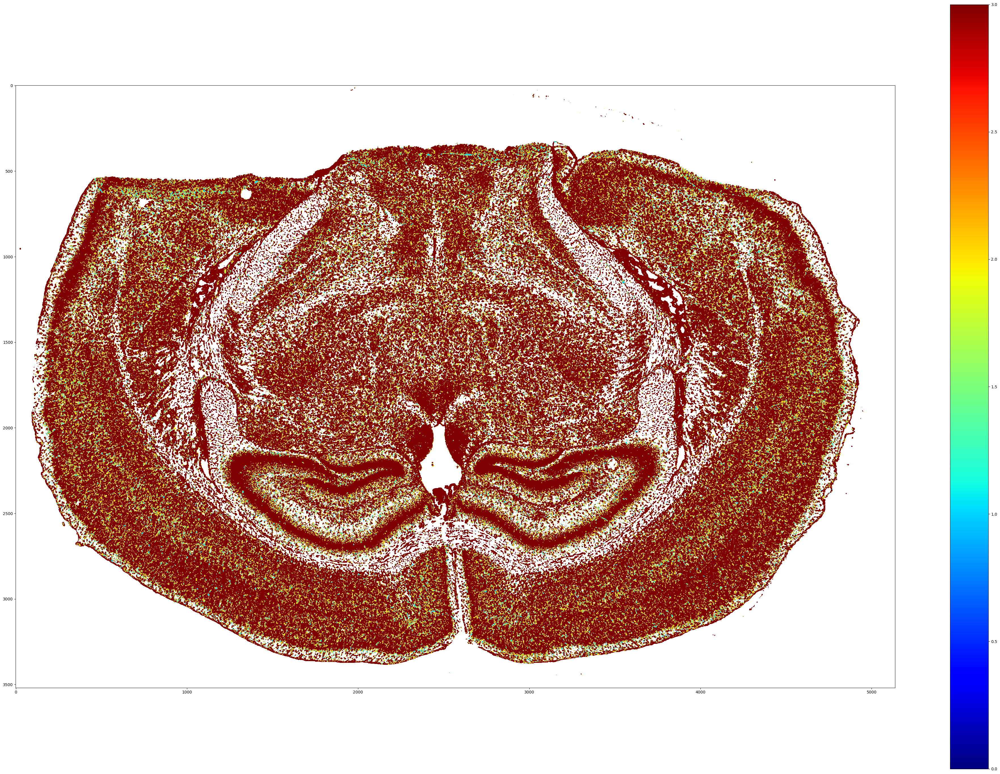

In [45]:
plt.figure(figsize=(50,35))

coherence_steps = np.zeros_like(coherence_)*np.nan

coherence_steps[coherence_>0]=1
coherence_steps[coherence_>0.5]=2
coherence_steps[coherence_>(1/2**0.5)]=3

plt.imshow(coherence_steps.T,cmap='jet',vmin=0, interpolation='none')

plt.colorbar()